
Hugo Abelheira - 202409899 |  Tiago Coelho - 202105004


# **Assignment 1 - Assembling Lego Kits - Computer Vision 25/26**

This project focuses on the development of a computer vision system capable of automatically identifying and classifying LEGO-like bricks in images captured from a production line. The main objectives include camera calibration, color-based segmentation of individual bricks, and the analysis of complete LEGO kits to verify their composition.

### Imports

In [1]:
!pip install opencv-python-headless==4.10.0.84 numpy matplotlib requests --quiet

import os
import zipfile
import requests
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import glob
import pandas as pd
import cv2


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 6.8 MB/s eta 0:00:00


### Data Loading

In [2]:
DATA_DIR = '/content/data'
ZIP_PATH = os.path.join(DATA_DIR, "assign1_data.zip")
EXTRACT_FLAG = os.path.join(DATA_DIR, ".extracted_ok")

os.makedirs(DATA_DIR, exist_ok=True)

In [3]:
FILE_ID = "1XzAnjgV1htuhzMS26DYOtFJBtfxJqFrS"  # ID do ficheiro na drive
ZIP_URL = f"https://drive.google.com/uc?id={FILE_ID}"

if not os.path.exists(EXTRACT_FLAG):
    if not os.path.exists(ZIP_PATH):
        print("📥 Downloading dataset from Google Drive...")
        !gdown --id {FILE_ID} -O {ZIP_PATH}
        print("✅ Download complete!")

    print("📦 Extracting files...")
    with zipfile.ZipFile(ZIP_PATH, 'r') as zip_ref:
        zip_ref.extractall(DATA_DIR)

    with open(EXTRACT_FLAG, "w") as f:
        f.write("done")

    print("✅ Extraction completed successfully!\n")
else:
    print("✅ Dataset already available.\n")

📥 Downloading dataset from Google Drive...
/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1XzAnjgV1htuhzMS26DYOtFJBtfxJqFrS
From (redirected): https://drive.google.com/uc?id=1XzAnjgV1htuhzMS26DYOtFJBtfxJqFrS&confirm=t&uuid=016fb6cb-e023-4f75-b25b-4b2b61103f5e
To: /content/data/assign1_data.zip
100% 54.8M/54.8M [00:01<00:00, 50.5MB/s]
✅ Download complete!
📦 Extracting files...
✅ Extraction completed successfully!



# **1 - Calibration images:**

### **(a) Three intrinsic calibration attempts were made to determine the intrinsic parameters and lens distortion of the camera. The calibration attempts are contained in folders Calib1, Calib2 and Calib3. For each attempt, present the intrinsic matrix, the lens distortion coefficients and the re-projection error. Select the best calibration and justify (in 2 sentences).**
Note: A chessboard with configuration
12x9 and square size 15 mm was used.

These cells perform camera calibration using chessboard pattern images.  
The `calibrate_folder` function loads all images in a folder, detects and refines chessboard corners, and computes the camera intrinsic matrix, distortion coefficients, and mean reprojection error.  
Then, `print_report` displays a summary of each calibration.  
Finally, the code compares the three calibrations (`calib1`, `calib2`, `calib3`) and automatically selects the one with the lowest reprojection error.


In [4]:
def calibrate_folder(folder_path, pattern_size=(12,9), square_size=15.0):
    # Termination criteria for corner refinement (sub-pixel accuracy)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

    # Prepare 3D points of the chessboard corners (in millimeters)
    objp = np.zeros((pattern_size[0]*pattern_size[1], 3), np.float32)
    objp[:, :2] = np.mgrid[0:pattern_size[0], 0:pattern_size[1]].T.reshape(-1, 2)
    objp = objp * square_size  # scale to mm

    objpoints = []   # 3D points in real world space
    imgpoints = []   # 2D points in image plane
    img_shape = None # to store image size

    # Load all images in the folder
    images = []
    for ext in ("*.jpg", "*.jpeg", "*.png", "*.bmp"):
        images.extend(glob.glob(os.path.join(folder_path, ext)))

    if len(images) == 0:
        print(f"[ERROR] No images found in {folder_path}")
        return None

    for fname in images:
        img = cv2.imread(fname)
        if img is None:
            print(f"[WARNING] Invalid image file: {fname}")
            continue

        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


        # Save image size (width, height) only once
        if img_shape is None:
            img_shape = gray.shape[::-1]

        # Detect the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, pattern_size, None)

        if ret:
            # Refine corners to sub-pixel accuracy
            corners_refined = cv2.cornerSubPix(
                gray,
                corners,
                winSize=(11,11),
                zeroZone=(-1,-1),
                criteria=criteria
            )

            objpoints.append(objp)
            imgpoints.append(corners_refined)
        else:
            print(f"[WARNING] Chessboard not detected in {fname}")

    if len(objpoints) == 0:
        print(f"[ERROR] No chessboard patterns were detected in {folder_path}")
        return None

    # Perform camera calibration
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(
        objpoints,
        imgpoints,
        img_shape,
        None,
        None
    )

    # Compute overall mean reprojection error
    total_error = 0.0
    total_points = 0
    for i in range(len(objpoints)):
        imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
        err = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2)
        total_error += err**2
        total_points += len(imgpoints[i])
    mean_error = np.sqrt(total_error / total_points)

    return {
        "mtx": mtx,
        "dist": dist,
        "rvecs": rvecs,
        "tvecs": tvecs,
        "reprojection_error": mean_error,
        "n_images_used": len(objpoints)
    }

def print_report(name, calib):
    if calib is None:
        print(f"=== {name} ===")
        print("Calibration failed (no valid data).")
        return
    print(f"=== {name} ===")
    print(f"Images used               : {calib['n_images_used']}")
    print("Intrinsic matrix (mtx):")
    print(calib["mtx"])
    print("\nDistortion coefficients (dist): [k1 k2 p1 p2 k3 ...]")
    print(calib["dist"].ravel())
    print(f"\nMean reprojection error   : {calib['reprojection_error']:.6f} px\n")


In [5]:
calib1 = calibrate_folder("data/Calibration/calib1", pattern_size=(11,8), square_size=15.0)
calib2 = calibrate_folder("data/Calibration/calib2", pattern_size=(11,8), square_size=15.0)
calib3 = calibrate_folder("data/Calibration/calib3", pattern_size=(11,8), square_size=15.0)

print_report("calib1", calib1)
print_report("calib2", calib2)
print_report("calib3", calib3)

# choose the best automatically
calibs_validas = [(name,c) for name,c in [("calib1",calib1),("calib2",calib2),("calib3",calib3)] if c is not None]
best_name, best_calib = min(calibs_validas, key=lambda x: x[1]["reprojection_error"])

print(f"Best calibration: {best_name}")


[WARNING] Chessboard not detected in data/Calibration/calib2/calib_0.png
[WARNING] Chessboard not detected in data/Calibration/calib2/calib_32.png
[WARNING] Chessboard not detected in data/Calibration/calib3/calib_31.png
[WARNING] Chessboard not detected in data/Calibration/calib3/calib_7.png
=== calib1 ===
Images used               : 35
Intrinsic matrix (mtx):
[[827.57853341   0.         334.83380905]
 [  0.         827.43759225 281.31036033]
 [  0.           0.           1.        ]]

Distortion coefficients (dist): [k1 k2 p1 p2 k3 ...]
[-0.43653617  0.4033073  -0.00135037  0.00154943 -0.53358225]

Mean reprojection error   : 0.925691 px

=== calib2 ===
Images used               : 33
Intrinsic matrix (mtx):
[[838.86898078   0.         339.18767646]
 [  0.         839.12112322 276.55054239]
 [  0.           0.           1.        ]]

Distortion coefficients (dist): [k1 k2 p1 p2 k3 ...]
[-4.32056618e-01  2.84003244e-01 -2.67050949e-04  4.51436943e-04
 -1.46506345e-01]

Mean reprojectio

**Answer:** The best calibration was obtained with calib2, which achieved the lowest mean reprojection error of 0.0999 px, indicating the most accurate alignment between the projected 3D chessboard corners and their detected 2D image coordinates.

### **(b) The image ”final setup.png” represents the final inspection arrangement. Calibrate the extrinsic parameters of the camera setup. Present the extrinsic matrix and specify the pixel-to-millimeter conversion factor applied.**

This code loads the intrinsic parameters from the selected calibration and uses them to estimate the camera’s pose relative to the chessboard in the final setup image.  
After detecting and refining the chessboard corners, `solvePnP` computes the rotation and translation that map the 3D board coordinates to the image.  
The code then prints the rotation matrix, translation vector, and the combined extrinsic matrix `[R | t]`.  
Finally, it measures the pixel distance between two adjacent corners and uses it to estimate the physical scale in millimeters per pixel.


In [6]:

camera_matrix = calib2["mtx"]
dist_coeffs   = calib2["dist"]

# chessboard definition
pattern_size = (11,8)   # number of inner corners (columns, rows)
square_size  = 15.0     # mm

# build 3D object points for the board (same as before)
objp = np.zeros((pattern_size[0]*pattern_size[1], 3), np.float32)
objp[:, :2] = np.mgrid[0:pattern_size[0], 0:pattern_size[1]].T.reshape(-1, 2)
objp = objp * square_size  # now in millimeters

# === 2. Read final setup image ===
img_final = cv2.imread("data/Calibration/final_setup.png")
gray_final = cv2.cvtColor(img_final, cv2.COLOR_BGR2GRAY)

# detect corners in the final setup image
ret, corners = cv2.findChessboardCorners(gray_final, pattern_size, None)

if not ret:
    print("[ERROR] Chessboard not detected in final_setup.png")
else:
    # refine corners for higher accuracy
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
    corners_refined = cv2.cornerSubPix(
        gray_final,
        corners,
        winSize=(11,11),
        zeroZone=(-1,-1),
        criteria=criteria
    )

    # === 3. Solve for extrinsics ===
    # This estimates the pose of the chessboard with respect to the camera.
    success, rvec, tvec = cv2.solvePnP(
        objp,                 # 3D points (mm)
        corners_refined,      # 2D detected corners (px)
        camera_matrix,        # intrinsics from calib2
        dist_coeffs,          # distortion from calib2
        flags=cv2.SOLVEPNP_ITERATIVE
    )

    if not success:
        print("[ERROR] solvePnP failed.")
    else:
        # convert rotation vector to rotation matrix
        R, _ = cv2.Rodrigues(rvec)

        print("Extrinsic rotation matrix R:")
        print(R)

        print("\nExtrinsic translation vector t (in millimeters):")
        print(tvec)

        # We can also build the full [R | t] 3x4 matrix:
        extrinsic_matrix = np.hstack((R, tvec))
        print("\nExtrinsic matrix [R | t]:")
        print(extrinsic_matrix)

Extrinsic rotation matrix R:
[[-0.99839697 -0.01224026 -0.05526004]
 [ 0.00868116 -0.99789974  0.06419301]
 [-0.05592972  0.06361039  0.99640634]]

Extrinsic translation vector t (in millimeters):
[[ 64.21162092]
 [ 35.59385541]
 [266.66872896]]

Extrinsic matrix [R | t]:
[[-9.98396967e-01 -1.22402578e-02 -5.52600368e-02  6.42116209e+01]
 [ 8.68115815e-03 -9.97899742e-01  6.41930103e-02  3.55938554e+01]
 [-5.59297155e-02  6.36103857e-02  9.96406336e-01  2.66668729e+02]]


In [7]:
p1 = corners_refined[0][0]
p2 = corners_refined[1][0]
pixel_dist = np.linalg.norm(p1 - p2)

mm_per_pixel = 15.0 / pixel_dist
print(mm_per_pixel)


0.34302127


**Answer:** The pixel-to-millimeter conversion factor, obtained from the distance between two adjacent detected corners (corresponding to one 15 mm chessboard square), was found to be 0.343 mm/pixel, meaning that each pixel in the image corresponds to 0.343 millimeters in the real setup.

# **2 - Isolated brick images**

### **(a) Define a ROI (region of interest) for the image.**

This code first undistorts the raw image using the camera’s intrinsic parameters and distortion coefficients.  
Then, the `define_roi` function detects the main object region by thresholding the image, finding contours, and extracting the largest valid bounding box.  
It returns the cropped ROI along with a visualization of the detected area.  
Finally, the script displays the original image, the undistorted version, and the ROI highlighted on the corrected image.


In [8]:
def define_roi(
    image_bgr,
    display=True,
    gray_thresh=30,
    min_roi_area_fraction=0.05,
    margin=0,
    image_title=""
):
    h, w = image_bgr.shape[:2]

    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    _, binimg = cv2.threshold(gray, gray_thresh, 255, cv2.THRESH_BINARY)
    cnts, _ = cv2.findContours(binimg, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if cnts:
        x, y, bw, bh = cv2.boundingRect(max(cnts, key=cv2.contourArea))
        if bw * bh >= min_roi_area_fraction * h * w:
            x1, y1 = np.clip([x - margin, y - margin], 0, [w, h])
            x2, y2 = np.clip([x + bw + margin, y + bh + margin], [0, 0], [w, h])
        else:
            x1, y1, x2, y2 = 0, 0, w, h
    else:
        x1, y1, x2, y2 = 0, 0, w, h

    roi  = image_bgr[y1:y2, x1:x2]
    bbox = (int(x1), int(y1), int(x2 - x1), int(y2 - y1))

    vis = image_bgr.copy()
    cv2.rectangle(vis, (bbox[0], bbox[1]),
                  (bbox[0] + bbox[2] - 1, bbox[1] + bbox[3] - 1), (0, 255, 0), 3)

    if display:
        from google.colab.patches import cv2_imshow
        print(f"{image_title} ROI: x={bbox[0]}, y={bbox[1]}, w={bbox[2]}, h={bbox[3]}")
        cv2_imshow(vis)

    return roi, bbox, vis


In [9]:
def undistort_image(img_bgr, camera_matrix, dist_coeffs):
    h, w = img_bgr.shape[:2]

    # matriz intrínseca “ótima” para minimizar perda de campo de visão
    new_camera_mtx, roi = cv2.getOptimalNewCameraMatrix(
        camera_matrix, dist_coeffs, (w, h), 1, (w, h)
    )

    # remove distorção
    undistorted = cv2.undistort(img_bgr, camera_matrix, dist_coeffs, None, new_camera_mtx)

    # crop opcional com base na ROI retornada
    x, y, w_roi, h_roi = roi
    undistorted = undistorted[y:y+h_roi, x:x+w_roi]

    return undistorted


colored_bricks_undistorted ROI: x=0, y=0, w=605, h=441


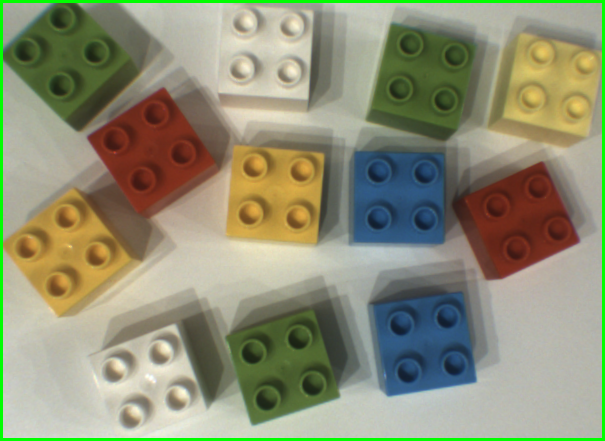

In [10]:
# 1) Ler imagem original
img_raw = cv2.imread("data/Isolated/colored_bricks.png")

# 2) Corrigir distorção da câmara
img_undist = undistort_image(img_raw, camera_matrix, dist_coeffs)

# 3) Encontrar ROI na imagem já corrigida
image_title = "colored_bricks_undistorted"
roi, bbox, vis_img = define_roi(img_undist, image_title=image_title)


Original:


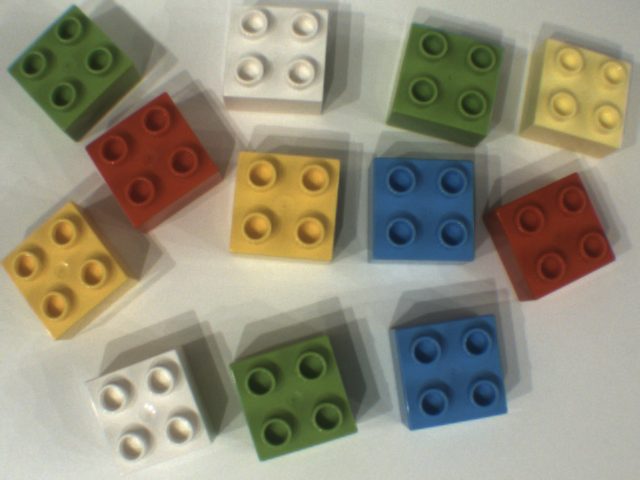

Undistorted:


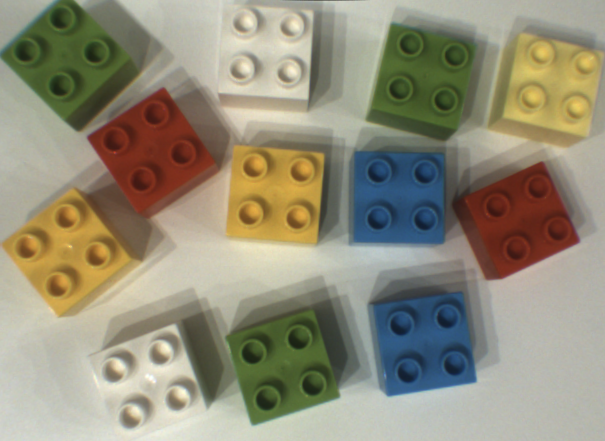

In [11]:
from google.colab.patches import cv2_imshow

print("Original:")
cv2_imshow(img_raw)
print("Undistorted:")
cv2_imshow(img_undist)


### **(b) - For image ”colored bricks.png”, count the number of bricks grouped by color**

This code performs color-based segmentation of LEGO-like bricks inside the ROI, incorporating background removal for more accurate detection.
It first removes the background using the get_foreground_mask() function and then converts the ROI to HSV to detect blue, green, yellow, and red bricks using predefined hue ranges.

All valid contours are filled into a segmentation image, counted, and stored along with their centroid and area information.

After detecting colored regions, these areas are removed from the ROI together with the background, leaving only potential white brick regions.

White bricks are then detected by converting the cleaned ROI to the LAB color space, applying CLAHE to the L channel, and computing a local “relief” map to highlight bright details.

Adaptive percentile thresholds on brightness and local contrast isolate white regions, which are then filtered by geometric constraints such as area, aspect ratio, and extent to ensure brick-like shapes.

Optional visualizations display intermediate processing steps or the final segmentation overlay.

Finally, the function returns the segmentation image, the number of detected bricks per color, the cleaned ROI used for white detection, and a list describing every detected brick.

In [12]:
def get_foreground_mask(roi_bgr, bg_roi_bgr, diff_thresh=12):
    """
    Máscara de foreground baseada na diferença para o background.
    Mantém a assinatura original, mas usa uma morfologia mais robusta
    para não remover partes dos blocos brancos.
    """
    if roi_bgr.shape[:2] != bg_roi_bgr.shape[:2]:
        bg_roi_bgr = cv2.resize(bg_roi_bgr, (roi_bgr.shape[1], roi_bgr.shape[0]))

    diff = cv2.absdiff(roi_bgr, bg_roi_bgr)
    gray = cv2.cvtColor(diff, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.GaussianBlur(gray, (5, 5), 0)

    _, mask = cv2.threshold(gray_blur, diff_thresh, 255, cv2.THRESH_BINARY)

    kernel3 = np.ones((3, 3), np.uint8)
    kernel5 = np.ones((5, 5), np.uint8)

    # Fecha buracos e remove ruído
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel5, iterations=3)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel3, iterations=1)

    # Remove componentes muito pequenos
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(mask, connectivity=8)
    mask_clean = np.zeros_like(mask)
    min_area = 300
    for i in range(1, num_labels):
        if stats[i, cv2.CC_STAT_AREA] >= min_area:
            mask_clean[labels == i] = 255

    # Pequena dilatação para garantir que não corta blocos
    mask_clean = cv2.dilate(mask_clean, kernel3, iterations=1)

    return mask_clean


In [13]:
bg_frame=cv2.imread("data/Calibration/background.png")
bg_roi=define_roi(bg_frame, display=False)[0]

In [14]:
def segment_and_classify_colors(
    roi_bgr,
    show_plot=True,
    debug_white=False,
    show_solution=False
):
    """
    Segment LEGO-like bricks: (1) HSV for blue/green/red/yellow; (2) remove colored regions and background from the ROI used for white; (3) detect white via LAB+CLAHE+relief+geometry.
    """
    roi_hsv = cv2.cvtColor(roi_bgr, cv2.COLOR_BGR2HSV)

    # --- 1) HSV color segmentation (strong colors) ---
    color_ranges = {
        "blue":   ((90,  50,  80), (135, 255, 255)),
        "green":  ((35,  60,  40), (100, 255, 255)),
        "yellow": ((15,  90, 128), (35, 255, 255)),
        "red1":   ((0,   60,  85), (10,  255, 255)),
        "red2":   ((170, 60,  85), (179, 255, 255)),
    }
    draw_colors = {
        "blue":   (255,   0,   0),
        "green":  (0,   255,   0),
        "red":    (0,     0, 255),
        "yellow": (0,   255, 255),
        "white":  (255, 255, 255),
    }

    counts = {"blue": 0, "green": 0, "red": 0, "yellow": 0, "white": 0}
    seg_img = np.zeros_like(roi_bgr)
    kernel3 = np.ones((3, 3), np.uint8)
    kernel5 = np.ones((5, 5), np.uint8)
    min_area_color = 1200

    mask_colors_all = np.zeros(roi_bgr.shape[:2], dtype=np.uint8)
    color_areas = []
    contours_by_color = {c: [] for c in ["blue","green","red","yellow","white"]}
    bricks = []

    for color, (lower, upper) in color_ranges.items():
        lower = np.array(lower, dtype=np.uint8)
        upper = np.array(upper, dtype=np.uint8)

        mask = cv2.inRange(roi_hsv, lower, upper)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN,  kernel3, iterations=1)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel3, iterations=1)

        cnts, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cnts = [c for c in cnts if cv2.contourArea(c) > min_area_color]

        color_label = "red" if color in ["red1", "red2"] else color
        for c in cnts:
            area = cv2.contourArea(c)
            color_areas.append(area)

            cv2.drawContours(seg_img, [c], -1, draw_colors[color_label], -1)
            cv2.drawContours(mask_colors_all, [c], -1, 255, -1)
            contours_by_color[color_label].append(c)

            M = cv2.moments(c)
            if M["m00"] != 0:
                cx = int(M["m10"] / M["m00"])
                cy = int(M["m01"] / M["m00"])
            else:
                cx, cy = -1, -1

            bricks.append({
                "color":   color_label,
                "cx":      cx,
                "cy":      cy,
                "contour": c,
                "area_px": area,
            })

        if color in ["red1","red2"]:
            counts["red"] += len(cnts)
        else:
            counts[color] = len(cnts)

    # --- 2) ROI used for white: remove colored blocks AND background mask ---
    kernel_big = np.ones((5, 5), np.uint8)
    mask_colors_solid = cv2.morphologyEx(mask_colors_all, cv2.MORPH_CLOSE, kernel_big, iterations=1)
    mask_colors_solid = cv2.dilate(mask_colors_solid, kernel_big, iterations=1)

    # background mask from your function (must exist: bg_roi_bgr)
    fg_mask_strict = get_foreground_mask(roi_bgr, bg_roi, diff_thresh=12)

    roi_clean = roi_bgr.copy()
    roi_clean[mask_colors_solid == 255] = (0, 0, 0)   # remove colored
    roi_clean[fg_mask_strict == 0]      = (0, 0, 0)   # remove background

    # --- 3) White detection (LAB + CLAHE + local relief + geometry) ---
    h_img, w_img = roi_bgr.shape[:2]
    lab_clean = cv2.cvtColor(roi_clean, cv2.COLOR_BGR2LAB)
    L, A, B = cv2.split(lab_clean)

    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(32, 32))
    L_eq = clahe.apply(L)
    L_bg = cv2.GaussianBlur(L_eq, (51, 51), 0)
    L_rel = cv2.subtract(L_eq, L_bg)

    roi_gray = cv2.cvtColor(roi_clean, cv2.COLOR_BGR2GRAY)
    base_mask = (roi_gray > 10)

    ref_area = float(np.median(color_areas)) if len(color_areas) > 0 else 4000.0
    white_contours = []

    if np.any(base_mask):
        L_vals = L_eq[base_mask].astype(np.float32)
        R_vals = L_rel[base_mask].astype(np.float32)
        thr_L = np.percentile(L_vals, 60.0)
        thr_R = np.percentile(R_vals, 55.0)

        mask_white = np.zeros_like(L_eq, dtype=np.uint8)
        mask_white[(L_eq >= thr_L) & (L_rel >= thr_R) & base_mask] = 255

        mask_white = cv2.morphologyEx(mask_white, cv2.MORPH_CLOSE, kernel5, iterations=2)
        mask_white = cv2.morphologyEx(mask_white, cv2.MORPH_OPEN,  kernel3, iterations=1)

        num_labels, labels_cc, stats, _ = cv2.connectedComponentsWithStats(mask_white, connectivity=8)
        min_area_white = max(600.0, 0.6 * ref_area)
        max_area_white = 2.2 * ref_area
        margin = 3

        for i in range(1, num_labels):
            x = stats[i, cv2.CC_STAT_LEFT]
            y = stats[i, cv2.CC_STAT_TOP]
            w_reg = stats[i, cv2.CC_STAT_WIDTH]
            h_reg = stats[i, cv2.CC_STAT_HEIGHT]
            area  = stats[i, cv2.CC_STAT_AREA]

            if area < min_area_white or area > max_area_white:
                continue

            aspect = max(w_reg, h_reg) / max(1, min(w_reg, h_reg))
            if aspect > 2.5:
                continue

            rect_area = float(w_reg * h_reg + 1e-5)
            extent = area / rect_area
            if extent < 0.55:
                continue

            comp_mask = (labels_cc == i).astype(np.uint8) * 255
            cnts_i, _ = cv2.findContours(comp_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if cnts_i:
                white_contours.append(max(cnts_i, key=cv2.contourArea))

    for c in white_contours:
        cv2.drawContours(seg_img, [c], -1, draw_colors["white"], -1)
        contours_by_color["white"].append(c)

        area = cv2.contourArea(c)
        M = cv2.moments(c)
        if M["m00"] != 0:
            cx = int(M["m10"] / M["m00"])
            cy = int(M["m01"] / M["m00"])
        else:
            cx, cy = -1, -1

        bricks.append({
            "color":   "white",
            "cx":      cx,
            "cy":      cy,
            "contour": c,
            "area_px": area,
        })

    counts["white"] = len(white_contours)

    # --- 4) Optional debug plots ---
    if show_plot:
        roi_rgb     = cv2.cvtColor(roi_bgr,   cv2.COLOR_BGR2RGB)
        seg_rgb     = cv2.cvtColor(seg_img,   cv2.COLOR_BGR2RGB)
        roi_clean_r = cv2.cvtColor(roi_clean, cv2.COLOR_BGR2RGB)

        # Guard for visualization when mask_white may not exist
        if 'mask_white' not in locals():
            mask_white = np.zeros(roi_bgr.shape[:2], np.uint8)

        plt.figure(figsize=(18, 8))
        plt.subplot(2, 3, 1); plt.imshow(roi_rgb);     plt.title("Original ROI");           plt.axis("off")
        plt.subplot(2, 3, 2); plt.imshow(seg_rgb);     plt.title("Final Segmentation");     plt.axis("off")
        plt.subplot(2, 3, 3); plt.imshow(roi_clean_r); plt.title("ROI without BG & colors");plt.axis("off")
        plt.subplot(2, 3, 4); plt.imshow(L_eq, cmap="gray");  plt.title("L (CLAHE)");       plt.axis("off")
        plt.subplot(2, 3, 5); plt.imshow(L_rel, cmap="gray"); plt.title("Relief");          plt.axis("off")
        plt.subplot(2, 3, 6); plt.imshow(mask_white, cmap="gray"); plt.title("White mask");plt.axis("off")
        plt.tight_layout(); plt.show()

    # --- 5) Optional contour-only overlay ---
    if show_solution:
        overlay = roi_bgr.copy()
        for color_name, contour_list in contours_by_color.items():
            if not contour_list:
                continue
            cv2.drawContours(overlay, contour_list, -1, draw_colors[color_name], 2)
        overlay_rgb = cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(6, 6))
        plt.imshow(overlay_rgb); plt.title("Contours on ROI"); plt.axis("off"); plt.show()

    return seg_img, counts, roi_clean, bricks


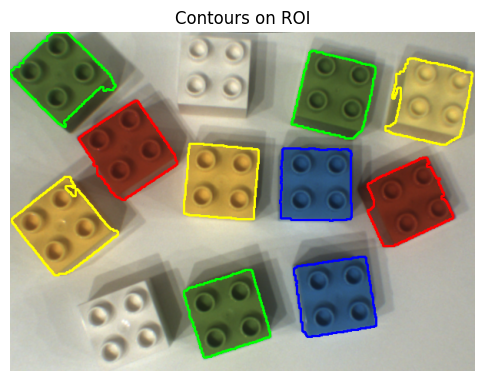

  Count of blocks by color: {'blue': 2, 'green': 3, 'red': 2, 'yellow': 3, 'white': 0}


In [15]:
seg_img, counts, roi_clean, bricks = segment_and_classify_colors(
    roi_bgr=roi,
    show_plot=False,
    debug_white=False,
    show_solution=True
)


print("  Count of blocks by color:", counts)



### **(c) - Consider images ”blue.png”, ”green.png”, ”red.png” and ”yellow.png”. Group the bricks by size and compute the average area and standard deviation of each brick size in millimeters. Show the result in a table similar to Table 2**

This block detects brick sizes from the segmentation and summarizes area statistics:

- **Stud-based sizing:** For each segmented brick, it finds studs with `HoughCircles`, computes a rotation-independent aspect ratio, and classifies the brick (`2x1`, `2x2`, `R2x2`, `2x4`, `2x6`) via `classify_by_studs_and_aspect`.
- **Overlays:** Draws contours, centroids, color labels, and (optionally) size labels on an `overlay`.
- **Per-image processing:** For each isolated color image (blue/green/red/yellow), runs segmentation → size detection, counts bricks, and groups their **pixel areas** by size.
- **Unit conversion & tables:** Converts areas to **mm²** using `mm_per_pixel²`, and prints per-image and global tables with average area, std. dev., and counts per size.


In [16]:
def classify_by_studs_and_aspect(n_studs, aspect_ratio):
    """
    Classify a LEGO-like brick based on the number of studs and its aspect ratio.

    Examples:
        2x1  ->  2 studs
        2x2  ->  4 studs and aspect ~ 1
        R2x2 ->  4 studs and aspect > ~1.3 (rotated 2x2)
        2x4  ->  8 studs
        2x6  -> 12 studs
    """
    if n_studs <= 0:
        return "unknown"

    if n_studs <= 3:
        return "2x1"

    if 3 < n_studs <= 5:
        if aspect_ratio < 1.25:
            return "2x2"
        else:
            return "R2x2"

    if 5 < n_studs <= 9:
        return "2x4"

    if n_studs > 9:
        return "2x6"

    return "unknown"


def detect_block_sizes_from_segmentation(
    roi_bgr,
    seg_img,
    draw_sizes=True,
    show_plot=False,
    debug_studs=False,
    image_title=""
):
    """
    Given the original ROI and a segmentation image (seg_img),
    this function detects each brick, calculates its centroid,
    counts studs using HoughCircles, and classifies its size.

    Parameters
    ----------
    roi_bgr     : np.ndarray
        ROI image in BGR format (already cropped, no undistortion)
    seg_img     : np.ndarray
        Segmented image with bricks color-coded by color (output of segment_and_classify_colors)
    draw_sizes  : bool
        If True, writes the size label (e.g., '2x4') on the overlay image
    show_plot   : bool
        If True, displays the ROI and the overlay side by side
    debug_studs : bool
        If True, shows detailed stud detection debug plots for selected bricks
    image_title : str
        Optional title text to display in stud debug windows

    Returns
    -------
    overlay : np.ndarray
        ROI image with contours, centroids, colors and (optionally) sizes drawn
    bricks  : list of dict
        Each entry corresponds to a brick:
            {
                "color":   str,
                "size":    str,
                "cx":      int,
                "cy":      int,
                "contour": contour
            }
    """

    gray_roi = cv2.cvtColor(roi_bgr, cv2.COLOR_BGR2GRAY)
    kernel   = np.ones((3, 3), np.uint8)
    overlay  = roi_bgr.copy()
    bricks   = []

    # ---------- Internal helper: stud detection (based on your original function) ----------
    def _detect_studs_in_block(brick_gray_masked, min_dim, color_name,
                               debug_studs=False, debug_title=""):
        """
        Detects studs within a single brick ROI using HoughCircles.

        Returns
        -------
        best_circles : np.ndarray
            Array of detected studs (x, y, r)
        n_studs : int
            Number of detected studs
        """

        # 1) Apply CLAHE to enhance local contrast
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        brick_clahe = clahe.apply(brick_gray_masked)

        # 2) Apply Gaussian blur
        blur = cv2.GaussianBlur(brick_clahe, (5, 5), 0)

        # 3) Base Hough parameters depending on color
        if color_name == "red":
            base_p2 = 24
        elif color_name == "blue":
            base_p2 = 28
        elif color_name == "yellow":
            base_p2 = 26
        else:  # green / other
            base_p2 = 28

        # 4) Radius range for HoughCircles
        min_radius = int(min_dim * 0.06)
        max_radius = int(min_dim * 0.18)
        if min_radius < 2:
            min_radius = 2
        if max_radius <= min_radius:
            max_radius = min_radius + 2

        best_circles = None
        best_n = 0

        # ---------- First pass (standard parameters) ----------
        for p2 in [base_p2, base_p2 - 4, base_p2 + 4, base_p2 - 8]:
            if p2 < 10:
                continue

            circles = cv2.HoughCircles(
                blur,
                cv2.HOUGH_GRADIENT,
                dp=1.2,
                minDist=min_dim * 0.2,
                param1=80,
                param2=p2,
                minRadius=min_radius,
                maxRadius=max_radius
            )

            if circles is not None:
                circles = np.round(circles[0, :]).astype(int)
                n = len(circles)
            else:
                n = 0

            if n > best_n:
                best_n = n
                best_circles = circles

            # Stop early for valid stud counts
            if best_n in (8, 10, 12):
                break

        # ---------- Second pass (relaxed fallback) ----------
        if best_n == 0:
            fb_min_radius = int(min_dim * 0.04)
            fb_max_radius = int(min_dim * 0.20)
            if fb_min_radius < 2:
                fb_min_radius = 2
            if fb_max_radius <= fb_min_radius:
                fb_max_radius = fb_min_radius + 2

            for p2 in [base_p2 - 4, base_p2 - 6, base_p2 - 8]:
                if p2 < 8:
                    continue

                circles = cv2.HoughCircles(
                    blur,
                    cv2.HOUGH_GRADIENT,
                    dp=1.2,
                    minDist=max(4, int(min_dim * 0.15)),
                    param1=80,
                    param2=p2,
                    minRadius=fb_min_radius,
                    maxRadius=fb_max_radius
                )

                if circles is not None:
                    circles = np.round(circles[0, :]).astype(int)

                    # Filter by radius consistency
                    if len(circles) >= 3:
                        rs = circles[:, 2].astype(float)
                        r_med = np.median(rs)
                        mask = (rs >= 0.7 * r_med) & (rs <= 1.3 * r_med)
                        circles = circles[mask]
                    else:
                        r_med = np.mean(circles[:, 2].astype(float))

                    # Deduplicate overlapping centers
                    if len(circles) > 1:
                        circles_sorted = sorted(circles, key=lambda c: -c[2])
                        kept = []
                        for cx, cy, r in circles_sorted:
                            too_close = False
                            for kx, ky, kr in kept:
                                dist = np.hypot(cx - kx, cy - ky)
                                if dist < 0.7 * r_med:
                                    too_close = True
                                    break
                            if not too_close:
                                kept.append([cx, cy, r])
                        circles = np.array(kept, dtype=int)

                    n = len(circles)
                else:
                    n = 0

                if n > best_n:
                    best_n = n
                    best_circles = circles

        if best_circles is None:
            best_circles = np.array([]).reshape(0, 3)

        # Optional debug visualization
        if debug_studs:
            dbg = cv2.cvtColor(blur, cv2.COLOR_GRAY2BGR)
            for (cx, cy, r) in best_circles:
                cv2.circle(dbg, (cx, cy), r, (0, 255, 0), 2)
                cv2.circle(dbg, (cx, cy), 2, (255, 0, 0), -1)

            print(f"[DEBUG KIT] {debug_title} | color={color_name}, studs={len(best_circles)}")
            plt.figure(figsize=(4, 4))
            plt.imshow(dbg, cmap="gray")
            plt.title(f"{color_name} - studs={len(best_circles)}")
            plt.axis("off")
            plt.show()

        return best_circles, len(best_circles)

    # ---------- Main loop over colors (based on segmentation) ----------
    for color_name, bgr in DRAW_COLORS_BGR.items():
        lower = np.array(bgr, dtype=np.uint8)
        upper = np.array(bgr, dtype=np.uint8)
        mask  = cv2.inRange(seg_img, lower, upper)

        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN,  kernel, iterations=1)

        cnts, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        for c in cnts:
            area_px = cv2.contourArea(c)
            if area_px < 1000:
                continue

            # Compute centroid
            M = cv2.moments(c)
            if M["m00"] == 0:
                continue
            cx = int(M["m10"] / M["m00"])
            cy = int(M["m01"] / M["m00"])

            size_label = "unknown"

            # Rotation-independent aspect ratio
            rect = cv2.minAreaRect(c)
            w_rect, h_rect = rect[1]
            if w_rect == 0 or h_rect == 0:
                aspect_ratio = 1.0
            else:
                aspect_ratio = max(w_rect, h_rect) / min(w_rect, h_rect)

            # Extract block region (axis-aligned bounding box)
            x, y, w, h = cv2.boundingRect(c)
            brick_gray = gray_roi[y:y + h, x:x + w]

            # Create block mask
            mask_block = np.zeros_like(gray_roi, dtype=np.uint8)
            cv2.drawContours(mask_block, [c], -1, 255, thickness=-1)
            mask_block = mask_block[y:y + h, x:x + w]
            brick_gray_masked = cv2.bitwise_and(brick_gray, brick_gray, mask=mask_block)

            # min_dim robust to rotation
            if w_rect > 0 and h_rect > 0:
                min_dim = int(min(w_rect, h_rect))
            else:
                min_dim = min(w, h)

            # --- Detect studs ---
            circles, n_studs = _detect_studs_in_block(
                brick_gray_masked,
                min_dim,
                color_name,
                debug_studs=debug_studs,
                debug_title=image_title
            )

            # --- Classify brick size by stud count + aspect ratio ---
            size_label = classify_by_studs_and_aspect(n_studs, aspect_ratio)

            # --- Draw contour, centroid and labels ---
            bgr_draw = DRAW_COLORS_BGR[color_name]

            cv2.drawContours(overlay, [c], -1, bgr_draw, 2)          # contour
            cv2.circle(overlay, (cx, cy), 4, (0, 0, 255), -1)        # centroid

            cv2.putText(
                overlay,
                color_name,
                (cx - 25, cy - 10),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.6,
                (255, 255, 255),
                2,
                cv2.LINE_AA
            )

            if draw_sizes:
                cv2.putText(
                    overlay,
                    size_label,
                    (cx - 20, cy + 20),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    0.6,
                    (255, 255, 255),
                    2,
                    cv2.LINE_AA
                )

            bricks.append({
                "color":   color_name,
                "size":    size_label,
                "cx":      cx,
                "cy":      cy,
                "contour": c,
            })

    # ---------- Optional visualization ----------
    if show_plot:
        roi_rgb     = cv2.cvtColor(roi_bgr,    cv2.COLOR_BGR2RGB)
        overlay_rgb = cv2.cvtColor(overlay,    cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(12, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(roi_rgb)
        plt.title(f"{image_title} - ROI (input)")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(overlay_rgb)
        if draw_sizes:
            plt.title("Bricks, centroids and sizes (studs)")
        else:
            plt.title("Bricks and centroids")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

    return overlay, bricks



=== Processing image: blue.png (dominant color: blue) ===


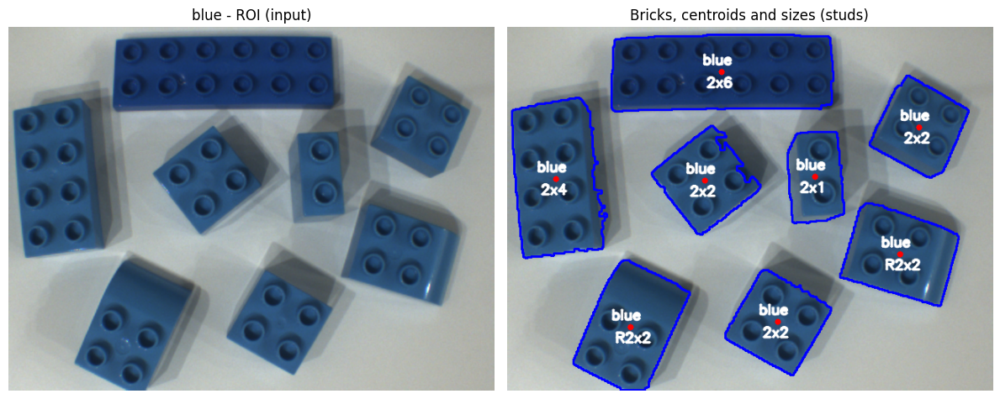

Number of bricks detected: 8

Table for blue.png:
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x1           7731.5            909.72              0.00      1
2x2          10727.3           1262.22             36.28      3
2x4          20849.0           2453.17              0.00      1
2x6          27727.5           3262.52              0.00      1
R2x2         14893.8           1752.45            154.55      2

=== Processing image: green.png (dominant color: green) ===


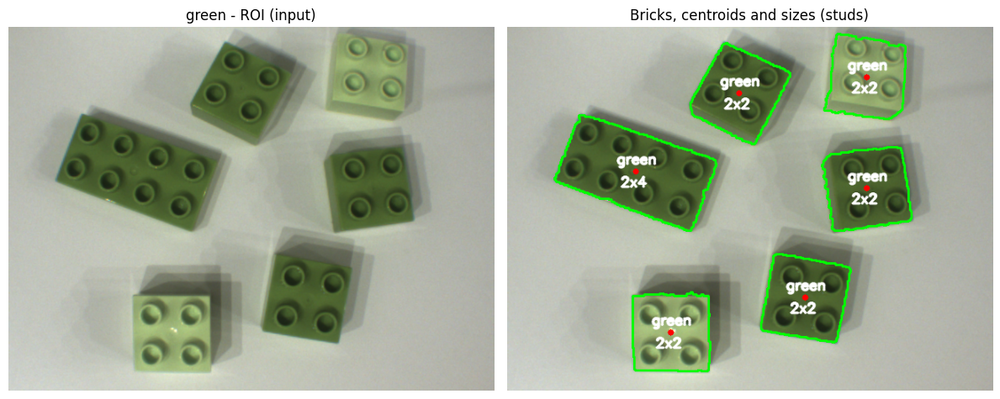

Number of bricks detected: 6

Table for green.png:
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x2          10188.7           1198.84             46.16      5
2x4          18734.0           2204.31              0.00      1

=== Processing image: red.png (dominant color: red) ===


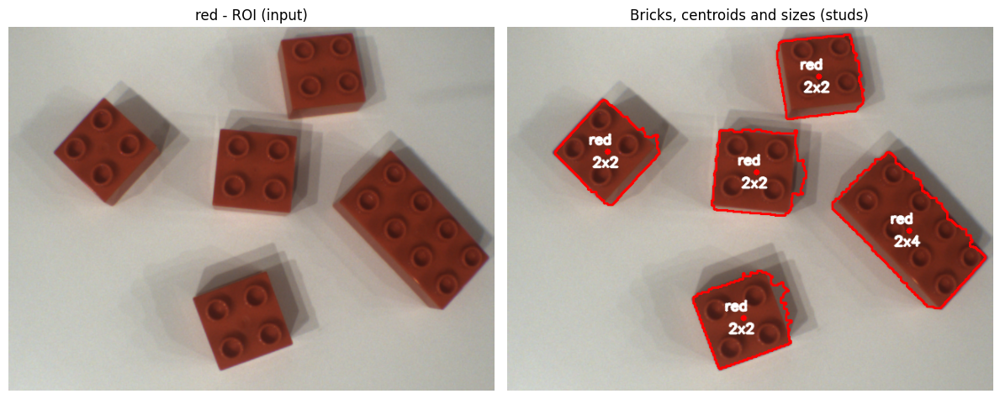

Number of bricks detected: 5

Table for red.png:
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x2          10839.4           1275.40             73.47      4
2x4          20080.0           2362.68              0.00      1

=== Processing image: yellow.png (dominant color: yellow) ===


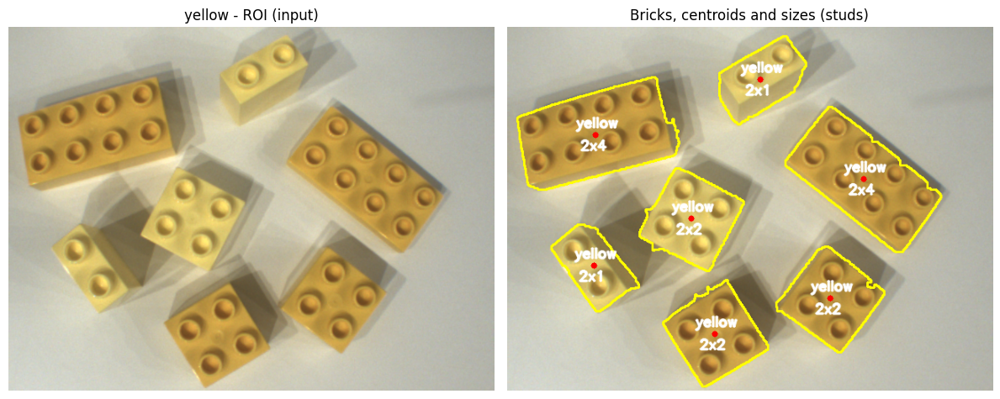

Number of bricks detected: 7

Table for yellow.png:
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x1           7348.8            864.68             80.33      2
2x2          10801.0           1270.88             14.07      3
2x4          19859.0           2336.68            148.60      2

=== Global table (blue + green + red + yellow) ===
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x1           7476.3            879.69             62.47      3
2x2          10592.4           1246.34             56.68     15
2x4          19876.2           2338.71            116.00      5
2x6          27727.5           3262.52              0.00      1
R2x2         14893.8           1752.45            154.55      2


In [17]:
import os
import cv2
import numpy as np

mm2_per_pixel = mm_per_pixel ** 2  # area (mm²) of a single pixel

color_images = {
    "blue":   "data/Isolated/blue.png",
    "green":  "data/Isolated/green.png",
    "red":    "data/Isolated/red.png",
    "yellow": "data/Isolated/yellow.png",
}
DRAW_COLORS_BGR = {
    "blue":   (255,   0,   0),
    "green":  (0,   255,   0),
    "red":    (0,     0, 255),
    "yellow": (0,   255, 255),
    "white":  (255, 255, 255),
}

# To accumulate global statistics across all 4 images
global_areas_by_size = {}

for color_name, path in color_images.items():
    print(f"\n=== Processing image: {os.path.basename(path)} (dominant color: {color_name}) ===")

    img = cv2.imread(path)
    if img is None:
        print(f"[ERROR] Could not read image: {path}")
        continue

    # Use the full image as ROI for isolated bricks
    roi = img.copy()

    # 1) Color segmentation (gets contours and pixel areas)
    seg_img, counts, roi_clean, bricks_seg = segment_and_classify_colors(
        roi_bgr=roi,
        show_plot=False,
        debug_white=False,
        show_solution=False
    )

    # 2) Size detection (studs) + overlay with color & size labels
    overlay, bricks = detect_block_sizes_from_segmentation(
        roi_bgr=roi,
        seg_img=seg_img,
        draw_sizes=True,
        show_plot=True,
        debug_studs=False,
        image_title=color_name
    )


    print(f"Number of bricks detected: {len(bricks)}")

    # --- build per-image statistics: group areas by SIZE ---
    areas_by_size = {}

    for b in bricks:
        size_label = b.get("size", "unknown")
        if size_label == "unknown":
            continue  # skip bricks where the size was not detected

        # area in pixels: prefer 'area_px' if present; otherwise compute from contour
        contour = b["contour"]
        area_px = b.get("area_px", cv2.contourArea(contour))

        if size_label not in areas_by_size:
            areas_by_size[size_label] = []
        areas_by_size[size_label].append(area_px)

        # also accumulate for the global table
        if size_label not in global_areas_by_size:
            global_areas_by_size[size_label] = []
        global_areas_by_size[size_label].append(area_px)

    # --- print per-image table (like the statement asks, but per file) ---
    print(f"\nTable for {os.path.basename(path)}:")
    header = f"{'Size':<6} {'Avg Area (px)':>14} {'Avg Area (mm^2)':>18} {'Std dev (mm^2)':>18} {'Count':>7}"
    print(header)
    print("-" * len(header))

    for size_label in sorted(areas_by_size.keys()):
        areas_px = np.array(areas_by_size[size_label], dtype=float)
        avg_area_px = areas_px.mean()
        avg_area_mm2 = avg_area_px * mm2_per_pixel
        std_area_mm2 = (areas_px.std(ddof=1) if len(areas_px) > 1 else 0.0) * mm2_per_pixel

        print(
            f"{size_label:<6}"
            f"{avg_area_px:14.1f}"
            f"{avg_area_mm2:18.2f}"
            f"{std_area_mm2:18.2f}"
            f"{len(areas_px):7d}"
        )

# ---------- global table across all 4 color images ----------
print("\n=== Global table (blue + green + red + yellow) ===")
header = f"{'Size':<6} {'Avg Area (px)':>14} {'Avg Area (mm^2)':>18} {'Std dev (mm^2)':>18} {'Count':>7}"
print(header)
print("-" * len(header))

for size_label in sorted(global_areas_by_size.keys()):
    areas_px = np.array(global_areas_by_size[size_label], dtype=float)
    avg_area_px = areas_px.mean()
    avg_area_mm2 = avg_area_px * mm2_per_pixel
    std_area_mm2 = (areas_px.std(ddof=1) if len(areas_px) > 1 else 0.0) * mm2_per_pixel

    print(
        f"{size_label:<6}"
        f"{avg_area_px:14.1f}"
        f"{avg_area_mm2:18.2f}"
        f"{std_area_mm2:18.2f}"
        f"{len(areas_px):7d}"
    )


# **3 - Kit images**

### **The Lego factory manufactures multiple kits, each consisting of bricks of specific colors and sizes required to assemble different products. Figure 2 illustrates the three complete kits that need to be prepared for packaging and delivery. A kit is considered complete only if it contains the exact number of bricks specified for that kit, distinguished by both color and size.**
Note: Assume that the data collected by the
inspection system on the assembly line corresponds to a complete kit.

### **(a) - Display the bricks detections and their centroids for each image**

Runs the full kit-analysis pipeline on each kit image:

- **Undistort → ROI:** Reads the image, undistorts with the given intrinsics/distortion, and auto-defines a region of interest.
- **Color segmentation:** Finds bricks by color and builds a segmentation mask.
- **Stud sizing (optional):** Detects studs and classifies sizes; draws contours/centroids and, if enabled, size labels on an overlay.
- **Visualization:** Shows side-by-side ROI and overlay.
- **Output per image:** Prints a compact table listing each detected brick’s color, size (if enabled), and centroid `(cx, cy)`.


In [18]:
import os
import cv2
import matplotlib.pyplot as plt


def analyze_kit_image(
    img_path,
    camera_matrix,
    dist_coeffs,
    show_plot=True,
    draw_sizes=False,
    debug_studs=False,
    debug_white=False
):
    """
    Analyze a kit image:
      - undistort the image
      - define a ROI
      - segment bricks by color
      - detect studs and classify brick size
      - return the annotated ROI and the list of bricks

    Parameters
    ----------
    img_path      : str
        Path to the input image.
    camera_matrix : np.ndarray
        Camera matrix used for undistortion.
    dist_coeffs   : np.ndarray
        Distortion coefficients.
    show_plot     : bool, optional
        If True, shows a figure with ROI and final overlay.
    draw_sizes    : bool, optional
        If True, draws size labels (e.g. '2x4') next to each brick.
    debug_studs   : bool, optional
        If True, enables stud-detection debugging inside
        detect_block_sizes_from_segmentation.
    debug_white   : bool, optional
        If True, enables extra debugging for white-brick detection
        inside segment_and_classify_colors.

    Returns
    -------
    overlay : np.ndarray
        Annotated ROI (contours, colors and optionally sizes).
    bricks  : list of dict
        List of detected bricks with fields such as:
        'color', 'size', 'cx', 'cy', 'contour', (and possibly 'area_px').
    """

    img = cv2.imread(img_path)
    if img is None:
        raise RuntimeError(f"Could not read image: {img_path}")

    # 1) Undistort
    img_undist = cv2.undistort(img, camera_matrix, dist_coeffs)

    # 2) Define ROI (assumes define_roi is implemented elsewhere)
    image_title = os.path.basename(img_path)
    roi, bbox, _ = define_roi(img_undist, display=False, image_title=image_title)

    # 3) Color segmentation
    #    segment_and_classify_colors now returns:
    #    seg_img, counts, roi_clean, bricks_seg
    seg_img, counts_seg, roi_clean, bricks_seg = segment_and_classify_colors(
        roi_bgr=roi,
        show_plot=False,        # set True to see intermediate plots
        debug_white=debug_white,
        show_solution=False
    )

    # 4) Stud detection and size classification
    overlay, bricks = detect_block_sizes_from_segmentation(
        roi_bgr=roi,
        seg_img=seg_img,
        draw_sizes=draw_sizes,
        show_plot=False,
        debug_studs=debug_studs,
        image_title=image_title
    )

    # 5) Final plots for this function
    if show_plot:
        roi_rgb     = cv2.cvtColor(roi,     cv2.COLOR_BGR2RGB)
        overlay_rgb = cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(12, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(roi_rgb)
        plt.title(f"{image_title} - ROI (undistorted)")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(overlay_rgb)
        if draw_sizes:
            plt.title("Bricks, centroids and sizes (studs)")
        else:
            plt.title("Bricks and centroids")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

    return overlay, bricks



=== Processing kit1.png ===


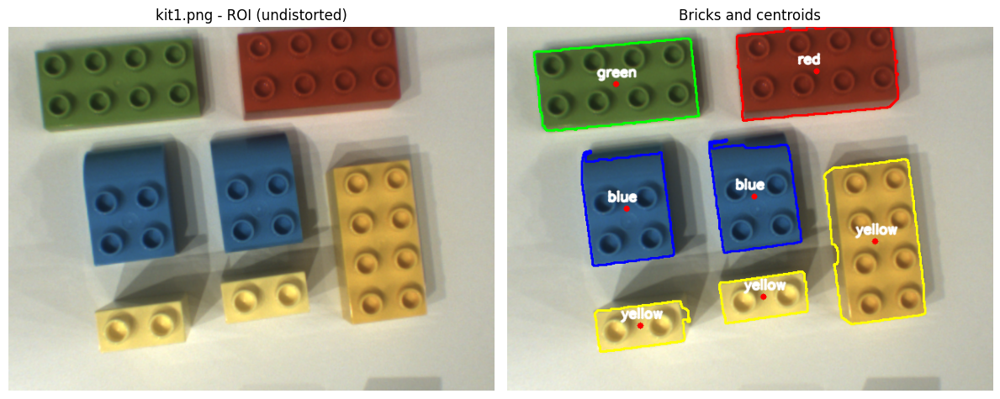

Detected bricks in kit1.png:
Idx    Color   Size     cx     cy
--------------------------------
  0     blue   R2x2    157    240
  1     blue   R2x2    325    224
  2    green    2x4    143     76
  3      red    2x4    407     59
  4   yellow    2x1    175    394
  5   yellow    2x1    337    356
  6   yellow    2x4    484    283

=== Processing kit2.png ===


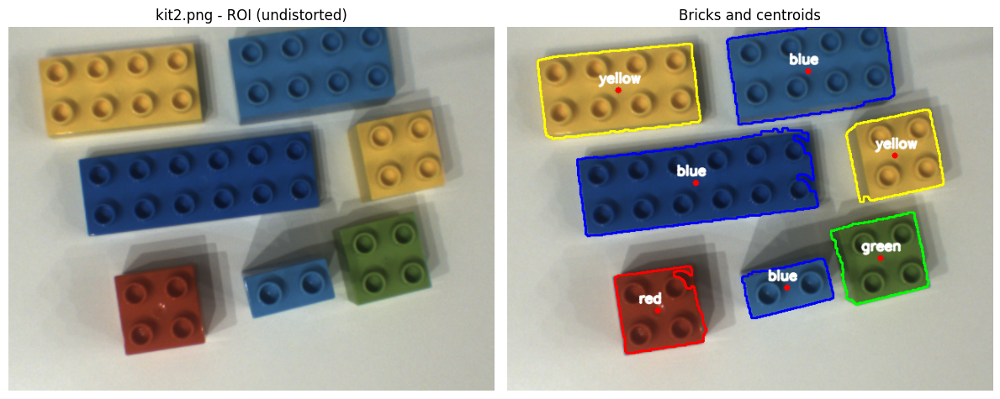

Detected bricks in kit2.png:
Idx    Color   Size     cx     cy
--------------------------------
  0     blue    2x1    368    344
  1     blue    2x6    248    206
  2     blue    2x4    396     59
  3    green    2x2    491    305
  4      red    2x2    198    374
  5   yellow    2x2    510    170
  6   yellow    2x4    146     84

=== Processing kit3.png ===


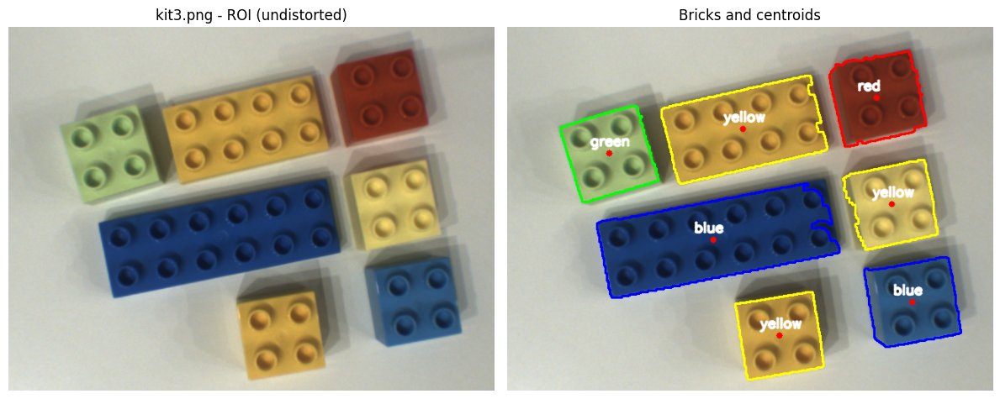

Detected bricks in kit3.png:
Idx    Color   Size     cx     cy
--------------------------------
  0     blue    2x2    533    363
  1     blue    2x6    271    281
  2    green    2x2    134    167
  3      red    2x2    486     94
  4   yellow    2x2    358    407
  5   yellow    2x2    506    234
  6   yellow    2x4    310    135

=== Processing ImageA_kit.png ===


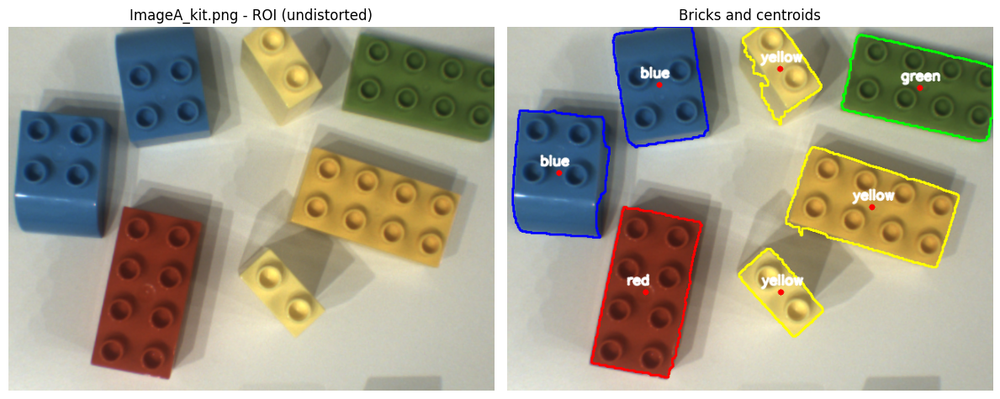

Detected bricks in ImageA_kit.png:
Idx    Color   Size     cx     cy
--------------------------------
  0     blue   R2x2     68    193
  1     blue   R2x2    200     77
  2    green    2x4    543     81
  3      red    2x4    182    350
  4   yellow    2x1    360    350
  5   yellow    2x4    480    238
  6   yellow    2x1    359     56

=== Processing ImageB_kit.png ===


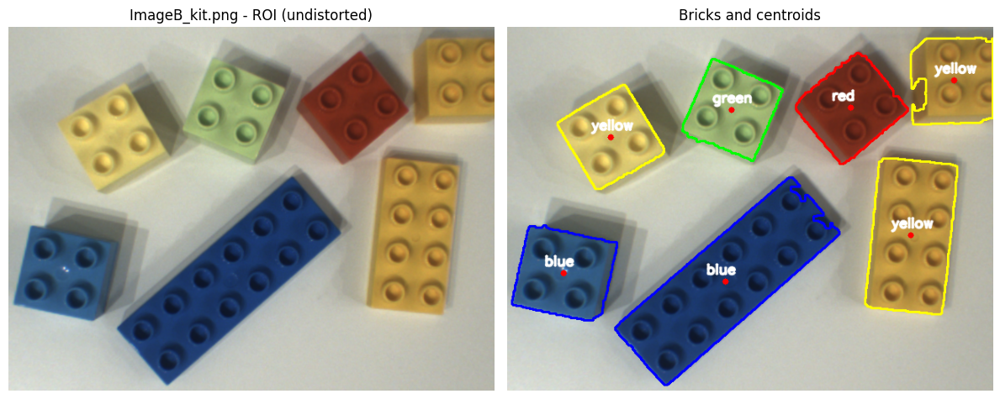

Detected bricks in ImageB_kit.png:
Idx    Color   Size     cx     cy
--------------------------------
  0     blue    2x2     74    325
  1     blue    2x6    287    336
  2    green    2x2    295    110
  3      red    2x2    452    107
  4   yellow    2x4    531    275
  5   yellow    2x2    136    146
  6   yellow    2x2    588     71

=== Processing ImageC_kit.png ===


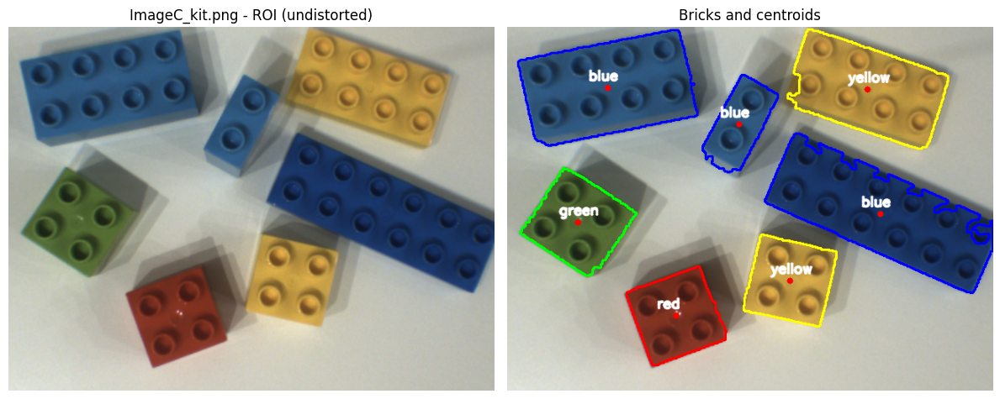

Detected bricks in ImageC_kit.png:
Idx    Color   Size     cx     cy
--------------------------------
  0     blue    2x6    491    247
  1     blue    2x1    305    129
  2     blue    2x4    132     81
  3    green    2x2     93    258
  4      red    2x2    222    381
  5   yellow    2x2    372    335
  6   yellow    2x4    474     83


In [19]:
kit_images = {

    "kit1.png": "data/Kit/kit1.png",
    "kit2.png": "data/Kit/kit2.png",
    "kit3.png": "data/Kit/kit3.png",
    "ImageA_kit.png": "data/Kit/ImageA_kit.png",
    "ImageB_kit.png": "data/Kit/ImageB_kit.png",
    "ImageC_kit.png": "data/Kit/ImageC_kit.png",
}

for kit_name, img_path in kit_images.items():
    print(f"\n=== Processing {kit_name} ===")

    # Run the full analysis pipeline on the kit image
    overlay, bricks = analyze_kit_image(
        img_path=img_path,
        camera_matrix=camera_matrix,
        dist_coeffs=dist_coeffs,
        show_plot=True,
        draw_sizes=False,
        debug_studs=False,
        debug_white=False
    )

    # Print a small table with brick detections and centroids
    print(f"Detected bricks in {kit_name}:")
    print(f"{'Idx':>3s} {'Color':>8s} {'Size':>6s} {'cx':>6s} {'cy':>6s}")
    print("-" * 32)
    for i, b in enumerate(bricks):
        color = b.get("color", "NA")
        size  = b.get("size", "NA")
        cx    = b.get("cx", -1)
        cy    = b.get("cy", -1)
        print(f"{i:3d} {color:>8s} {size:>6s} {cx:6d} {cy:6d}")

### **(b) - Count the number of bricks by size and color for all images. Show the result in a table similar to Table 3.**

This final block processes every kit image, classifies each detected brick, and produces per-image and global count tables:

- Runs the full analysis pipeline (undistortion → ROI → color segmentation → stud-based size classification).
- For each brick, groups detections by **(size, color)** and counts how many appear in each image.
- Prints a formatted table per image listing size, color, and quantity.
- Aggregates all rows into a global DataFrame, sorted by image, size, and color, which summarizes all detections across the entire dataset.



=== Processing kit1.png ===


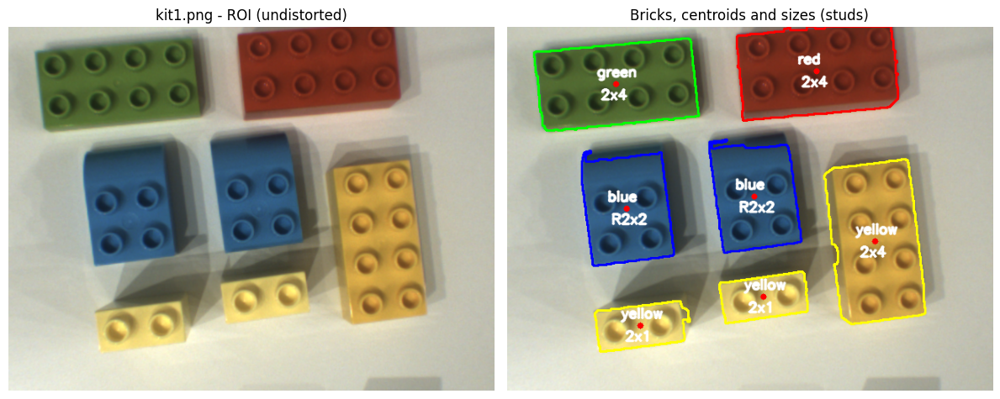

Table for kit1.png:
Image           Size   Color    Quantity
----------------------------------------
kit1.png        2x1    yellow          2
kit1.png        2x4    green           1
kit1.png        2x4    red             1
kit1.png        2x4    yellow          1
kit1.png        R2x2   blue            2

=== Processing kit2.png ===


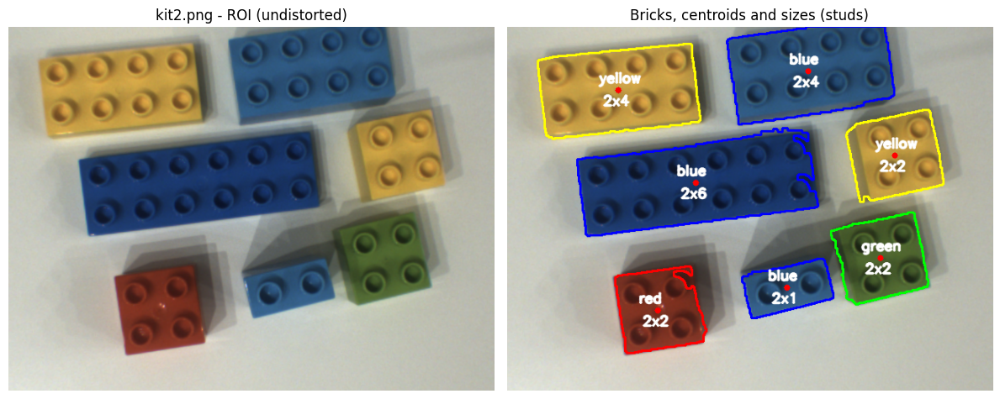

Table for kit2.png:
Image           Size   Color    Quantity
----------------------------------------
kit2.png        2x1    blue            1
kit2.png        2x2    green           1
kit2.png        2x2    red             1
kit2.png        2x2    yellow          1
kit2.png        2x4    blue            1
kit2.png        2x4    yellow          1
kit2.png        2x6    blue            1

=== Processing kit3.png ===


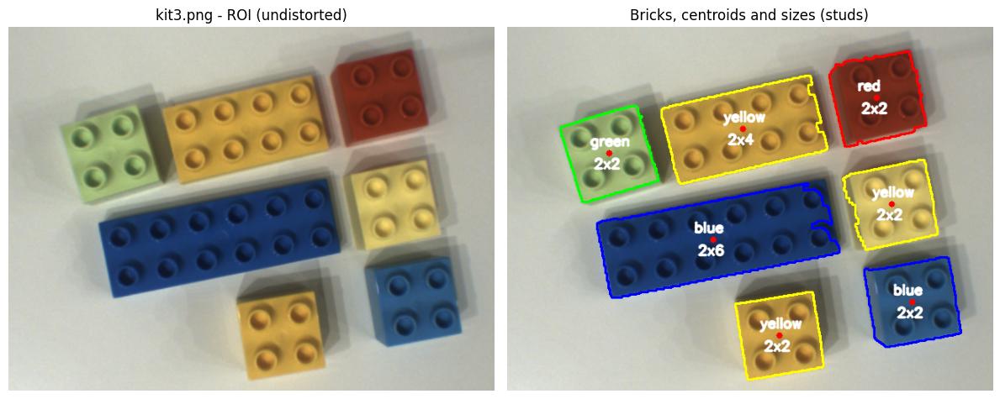

Table for kit3.png:
Image           Size   Color    Quantity
----------------------------------------
kit3.png        2x2    blue            1
kit3.png        2x2    green           1
kit3.png        2x2    red             1
kit3.png        2x2    yellow          2
kit3.png        2x4    yellow          1
kit3.png        2x6    blue            1

=== Processing ImageA_kit.png ===


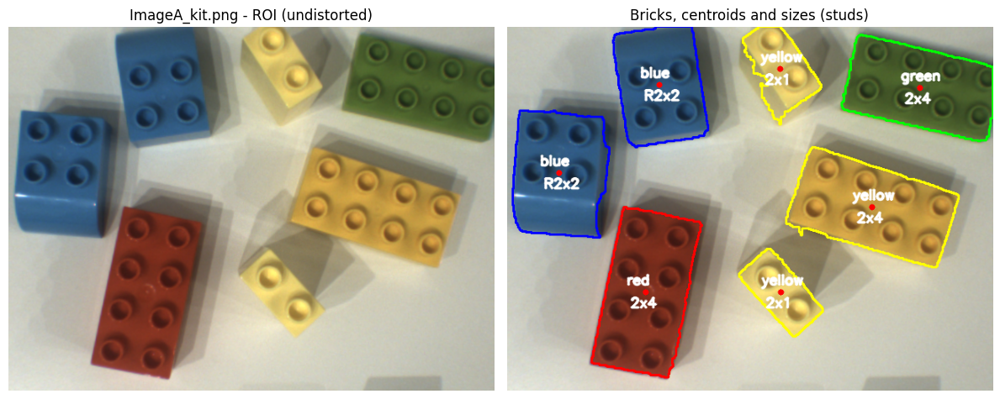

Table for ImageA_kit.png:
Image           Size   Color    Quantity
----------------------------------------
ImageA_kit.png  2x1    yellow          2
ImageA_kit.png  2x4    green           1
ImageA_kit.png  2x4    red             1
ImageA_kit.png  2x4    yellow          1
ImageA_kit.png  R2x2   blue            2

=== Processing ImageB_kit.png ===


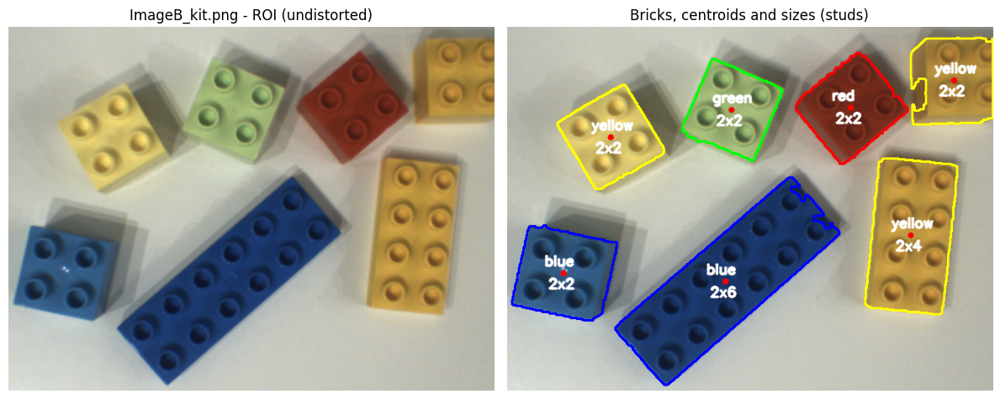

Table for ImageB_kit.png:
Image           Size   Color    Quantity
----------------------------------------
ImageB_kit.png  2x2    blue            1
ImageB_kit.png  2x2    green           1
ImageB_kit.png  2x2    red             1
ImageB_kit.png  2x2    yellow          2
ImageB_kit.png  2x4    yellow          1
ImageB_kit.png  2x6    blue            1

=== Processing ImageC_kit.png ===


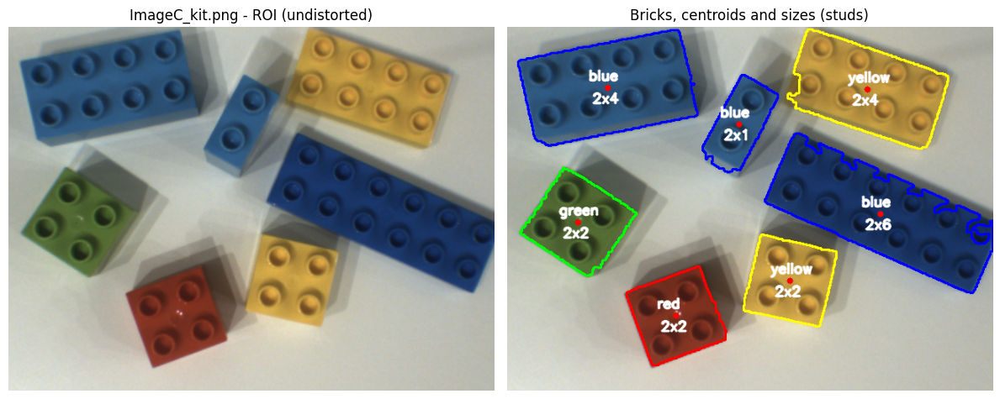

Table for ImageC_kit.png:
Image           Size   Color    Quantity
----------------------------------------
ImageC_kit.png  2x1    blue            1
ImageC_kit.png  2x2    green           1
ImageC_kit.png  2x2    red             1
ImageC_kit.png  2x2    yellow          1
ImageC_kit.png  2x4    blue            1
ImageC_kit.png  2x4    yellow          1
ImageC_kit.png  2x6    blue            1

=== Global table for question 3(b) ===


,Image,Size,Color,Quantity
18,ImageA_kit.png,2x1,yellow,2
19,ImageA_kit.png,2x4,green,1
20,ImageA_kit.png,2x4,red,1
21,ImageA_kit.png,2x4,yellow,1
22,ImageA_kit.png,R2x2,blue,2
23,ImageB_kit.png,2x2,blue,1
24,ImageB_kit.png,2x2,green,1
25,ImageB_kit.png,2x2,red,1
26,ImageB_kit.png,2x2,yellow,2
27,ImageB_kit.png,2x4,yellow,1


In [20]:
all_rows = []

for img_name, img_path in kit_images.items():
    print(f"\n=== Processing {img_name} ===")

    # Run the full analysis pipeline
    overlay, bricks = analyze_kit_image(
        img_path=img_path,
        camera_matrix=camera_matrix,
        dist_coeffs=dist_coeffs,
        show_plot=True,
        draw_sizes=True,
        debug_studs=False,
        debug_white=False
    )

    # --- count bricks by size and color ---
    counts = {}   # key: (size, color) -> quantity

    for b in bricks:
        size  = b.get("size", "unknown")
        color = b.get("color", "unknown")

        key = (size, color)
        counts[key] = counts.get(key, 0) + 1

    # --- print a table block for this image ---
    print(f"Table for {img_name}:")
    header = f"{'Image':<15} {'Size':<6} {'Color':<8} {'Quantity':>8}"
    print(header)
    print("-" * len(header))

    # sort rows by size then color
    for (size, color), qty in sorted(counts.items(), key=lambda x: (x[0][0], x[0][1])):
        print(f"{img_name:<15} {size:<6} {color:<8} {qty:8d}")

        # also save to global list
        all_rows.append({
            "Image": img_name,
            "Size": size,
            "Color": color,
            "Quantity": qty
        })

df_global = pd.DataFrame(all_rows)
df_global = df_global.sort_values(["Image", "Size", "Color"])

print("\n=== Global table for question 3(b) ===")
display(df_global)

### **(c) - Determine which pre-defined Lego kit (see Figure 2) corresponds to each image**

Builds a **kit signature** and matches unknown images to the correct reference kit:

- **Signature extraction:** Runs the full pipeline on each image and counts bricks by `(size, color)`, ignoring bricks whose size is `"unknown"`.  
  The result is a dictionary of the form `{(size, color): count}`.

- **Reference vs. unknown:** Computes signatures for the reference kits (`kit1`, `kit2`, `kit3`) and also for the unknown images (`ImageA_kit`, `ImageB_kit`, `ImageC_kit`).

- **Distance metric:** Compares two signatures using an L1 distance.  
  This distance is defined as the sum, over every `(size, color)` pair, of the absolute difference between the two counts.

- **Matching:** For each unknown kit image, computes its distance to every reference signature and selects the reference kit with the smallest distance.  
  It then prints the best match and the corresponding distance.


In [21]:
import numpy as np

def get_kit_signature(img_path, image_title=None):
    """
    Runs the full pipeline on a kit image and returns a signature:
        (size, color) -> count

    Unknown sizes (size == 'unknown') are ignored.
    """

    overlay, bricks = analyze_kit_image(
        img_path=img_path,
        camera_matrix=camera_matrix,
        dist_coeffs=dist_coeffs,
        show_plot=False,
        draw_sizes=True,
        debug_studs=False,
        debug_white=False
    )

    counts = {}
    for b in bricks:
        size  = b.get("size", "unknown")
        color = b.get("color", "unknown")

        if size == "unknown":
            # skip bricks where we could not detect the size
            continue

        key = (size, color)
        counts[key] = counts.get(key, 0) + 1

    if image_title is not None:
        print(f"\nSignature for {image_title}:")
        for (size, color), qty in sorted(counts.items()):
            print(f"  size={size:>4s}, color={color:>6s} -> {qty}")

    return counts


In [22]:
# Separate reference kits and unknown images automatically
reference_names = [name for name in kit_images if name.startswith("kit")]
unknown_names   = [name for name in kit_images if name.startswith("Image")]

# 1) signatures for reference kits kit1, kit2, kit3
reference_signatures = {}
for name in reference_names:
    path = kit_images[name]
    reference_signatures[name] = get_kit_signature(path, image_title=name)

# 2) signatures for ImageA_kit, ImageB_kit, ImageC_kit
unknown_signatures = {}
for name in unknown_names:
    path = kit_images[name]
    unknown_signatures[name] = get_kit_signature(path, image_title=name)



Signature for kit1.png:
  size= 2x1, color=yellow -> 2
  size= 2x4, color= green -> 1
  size= 2x4, color=   red -> 1
  size= 2x4, color=yellow -> 1
  size=R2x2, color=  blue -> 2

Signature for kit2.png:
  size= 2x1, color=  blue -> 1
  size= 2x2, color= green -> 1
  size= 2x2, color=   red -> 1
  size= 2x2, color=yellow -> 1
  size= 2x4, color=  blue -> 1
  size= 2x4, color=yellow -> 1
  size= 2x6, color=  blue -> 1

Signature for kit3.png:
  size= 2x2, color=  blue -> 1
  size= 2x2, color= green -> 1
  size= 2x2, color=   red -> 1
  size= 2x2, color=yellow -> 2
  size= 2x4, color=yellow -> 1
  size= 2x6, color=  blue -> 1

Signature for ImageA_kit.png:
  size= 2x1, color=yellow -> 2
  size= 2x4, color= green -> 1
  size= 2x4, color=   red -> 1
  size= 2x4, color=yellow -> 1
  size=R2x2, color=  blue -> 2

Signature for ImageB_kit.png:
  size= 2x2, color=  blue -> 1
  size= 2x2, color= green -> 1
  size= 2x2, color=   red -> 1
  size= 2x2, color=yellow -> 2
  size= 2x4, color=yellow 

In [23]:
def signature_distance(sig1, sig2):
    """
    L1 distance between two signatures:
        sum over all (size,color) of |count1 - count2|
    """
    all_keys = set(sig1.keys()) | set(sig2.keys())
    d = 0
    for k in all_keys:
        d += abs(sig1.get(k, 0) - sig2.get(k, 0))
    return d

print("=== Matching unknown kit images to reference kits ===")

for unk_name, unk_sig in unknown_signatures.items():
    best_ref = None
    best_dist = None

    for ref_name, ref_sig in reference_signatures.items():
        d = signature_distance(unk_sig, ref_sig)
        if best_dist is None or d < best_dist:
            best_dist = d
            best_ref  = ref_name

    print(f"{unk_name}  -->  best match: {best_ref}  (distance = {best_dist})")


=== Matching unknown kit images to reference kits ===
ImageA_kit.png  -->  best match: kit1.png  (distance = 0)
ImageB_kit.png  -->  best match: kit3.png  (distance = 0)
ImageC_kit.png  -->  best match: kit2.png  (distance = 0)


### **(d) - Provide some recommendations that the Lego factory should take into consideration to improve the performance of the sorting process based on image processing (e.g., imaging setup, calibration process and photometric effects), in 4 sentences**

**Answer:**
- The sorting performance could be improved by replacing the current directional lighting with a uniform, diffuse illumination setup to eliminate harsh shadows and specular reflections.

- The current side illumination produces uneven brightness that makes color segmentation unstable, especially on glossy bricks.

- Using a matte, neutral-colored background instead of white would increase contrast for light-colored bricks and reduce photometric ambiguity.

- Finally, adopting a consistent geometric and photometric calibration routine would ensure stable detection performance across sessions and different imaging conditions.

# **4 - Fault images**

### **Consider the kits shown in Figure 3. Using the Fault image set, assign each image to its corresponding kit or classify it as a Faulty kit. A kit is deemed faulty if it does not match any of the predefined kits, either due to a missing or surplus number of parts, or the inclusion of bricks that are not specified for that kit. In the case of a fault, automatically identify the cause.**

Classifies **fault images** by comparing detected brick signatures to reference kit specs:

- **Signature:** Runs the full pipeline on each fault image and counts bricks by `(size, color)` (ignores `size="unknown"`).
- **Compare to specs:** Computes L1 distance to each reference (`KitA`, `KitB`, `KitC`) and picks the closest kit.
- **Decision:** If distance = 0 → **perfect match** (no fault). Otherwise → **faulty**.
- **Diagnosis:** Compares the image signature to the chosen kit’s spec and lists **missing** and **extra** bricks with quantities.
- **Visualization:** Shows the overlay with detected bricks and size labels for quick inspection.


In [24]:
kit_fault_images = {

    "ImageA_fault.png": "data/Fault/ImageA_fault.png",
    "ImageB_fault.png": "data/Fault/ImageB_fault.png",
    "ImageC_fault.png": "data/Fault/ImageC_fault.png",
    "imageD_fault.png": "data/Fault/imageD_fault.png",
    "ImageE_fault.png": "data/Fault/ImageE_fault.png",
    "ImageF_fault.png": "data/Fault/ImageF_fault.png",

}

In [25]:
kit_reference_specs = {
    "KitA": {
        ("R2x2", "blue"):   1,
        ("2x4", "red"):    1,
        ("2x4", "green"):  1,
        ("2x2", "yellow"): 1,
        ("2x2", "red"):    1,
        ("2x1", "yellow"): 1,
    },
    "KitB": {
        ("R2x2", "blue"):   1,
        ("2x4", "yellow"): 1,
        ("2x4", "green"):  1,
        ("2x2", "yellow"): 1,
        ("2x2", "red"): 1,
        ("2x1", "yellow"): 1,
    },
    "KitC": {
        ("2x4", "blue"):   1,
        ("2x6", "blue"):  1,
        ("2x4", "yellow"):  1,
        ("2x2", "yellow"): 1,
        ("2x4", "red"):    1,
        ("2x4", "green"):  1,
    },
}


In [26]:
import numpy as np

def get_image_signature(img_path, title=None):
    """
    Runs the full pipeline on an image and returns a signature:
        (size, color) -> count

    Bricks with size == 'unknown' are ignored.
    """

    overlay, bricks = analyze_kit_image(
        img_path=img_path,
        camera_matrix=camera_matrix,
        dist_coeffs=dist_coeffs,
        show_plot=False,      # set True to see the detection
        draw_sizes=True,      # sizes are needed here
        debug_studs=False,
        debug_white=False
    )

    counts = {}
    for b in bricks:
        size  = b.get("size", "unknown")
        color = b.get("color", "unknown")

        if size == "unknown":
            continue  # ignore blocks where size was not detected

        key = (size, color)
        counts[key] = counts.get(key, 0) + 1

    if title is not None:
        print(f"\nSignature for {title}:")
        for (size, color), qty in sorted(counts.items()):
            print(f"  size={size:>4s}, color={color:>6s} -> {qty}")

    return counts, overlay, bricks


In [27]:
def signature_distance(sig1, sig2):
    """
    L1 distance between two signatures:
        sum over all (size,color) of |count1 - count2|
    """
    all_keys = set(sig1.keys()) | set(sig2.keys())
    d = 0
    for k in all_keys:
        d += abs(sig1.get(k, 0) - sig2.get(k, 0))
    return d


=== Fault kit classification ===

--- Processing ImageA_fault.png ---

Signature for ImageA_fault.png:
  size= 2x1, color=yellow -> 1
  size= 2x2, color=   red -> 1
  size= 2x2, color=yellow -> 1
  size= 2x4, color= green -> 1
  size= 2x4, color=yellow -> 1


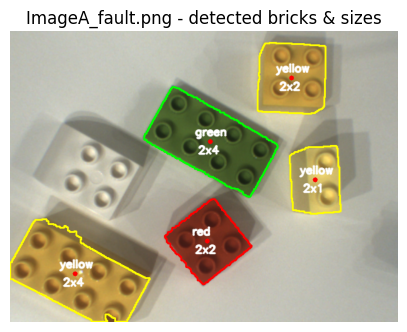

ImageA_fault.png: closest to KitB (distance = 1)
 -> Classified as FAULTY kit.
 -> Analysing cause...
  Missing bricks:
    - 1 x R2x2 blue

--- Processing ImageB_fault.png ---

Signature for ImageB_fault.png:
  size= 2x1, color=yellow -> 1
  size= 2x2, color=   red -> 1
  size= 2x2, color=yellow -> 1
  size= 2x4, color= green -> 1
  size= 2x4, color=   red -> 1
  size=R2x2, color=  blue -> 1


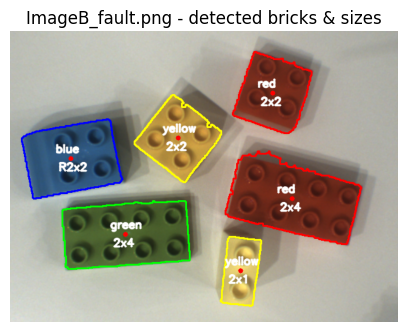

ImageB_fault.png: PERFECT MATCH with KitA (no fault).

--- Processing ImageC_fault.png ---

Signature for ImageC_fault.png:
  size= 2x2, color=  blue -> 2
  size= 2x2, color=yellow -> 1
  size= 2x4, color=  blue -> 1
  size= 2x4, color= green -> 1
  size= 2x4, color=   red -> 1
  size= 2x4, color=yellow -> 1


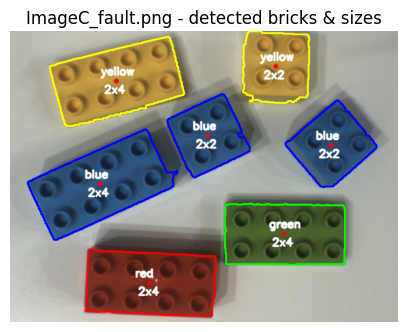

ImageC_fault.png: closest to KitC (distance = 3)
 -> Classified as FAULTY kit.
 -> Analysing cause...
  Missing bricks:
    - 1 x 2x6 blue
  Extra / unexpected bricks:
    - 2 x 2x2 blue

--- Processing imageD_fault.png ---

Signature for imageD_fault.png:
  size= 2x2, color=yellow -> 1
  size= 2x4, color=  blue -> 1
  size= 2x4, color= green -> 1
  size= 2x4, color=   red -> 1
  size= 2x4, color=yellow -> 1
  size= 2x6, color=  blue -> 1


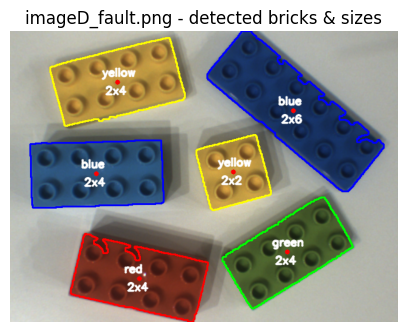

imageD_fault.png: PERFECT MATCH with KitC (no fault).

--- Processing ImageE_fault.png ---

Signature for ImageE_fault.png:
  size= 2x1, color=yellow -> 1
  size= 2x2, color=   red -> 1
  size= 2x2, color=yellow -> 1
  size= 2x4, color= green -> 1
  size= 2x4, color=yellow -> 1
  size=R2x2, color=  blue -> 1


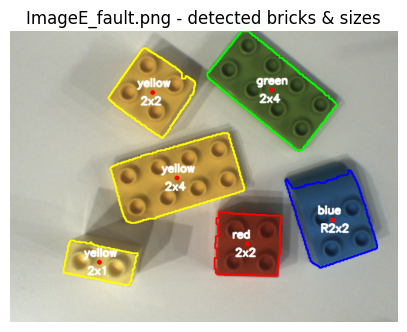

ImageE_fault.png: PERFECT MATCH with KitB (no fault).

--- Processing ImageF_fault.png ---

Signature for ImageF_fault.png:
  size= 2x1, color=  blue -> 1
  size= 2x2, color=   red -> 1
  size= 2x2, color=yellow -> 1
  size= 2x4, color= green -> 1
  size= 2x4, color=   red -> 1
  size=R2x2, color=  blue -> 1


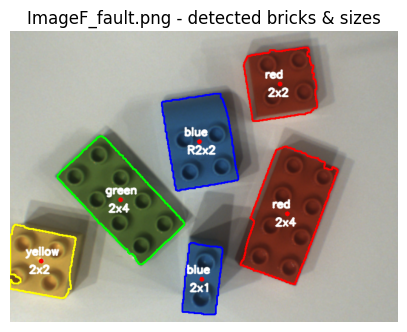

ImageF_fault.png: closest to KitA (distance = 2)
 -> Classified as FAULTY kit.
 -> Analysing cause...
  Missing bricks:
    - 1 x 2x1 yellow
  Extra / unexpected bricks:
    - 1 x 2x1 blue


In [28]:
import os
import matplotlib.pyplot as plt

print("=== Fault kit classification ===")

for img_name, img_path in kit_fault_images.items():
    print(f"\n--- Processing {img_name} ---")

    # 1) Get signature of the fault image
    sig_fault, overlay, bricks = get_image_signature(img_path, title=img_name)

    # (optional) show detection image
    overlay_rgb = cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(5, 5))
    plt.imshow(overlay_rgb)
    plt.title(f"{img_name} - detected bricks & sizes")
    plt.axis("off")
    plt.show()

    # 2) Compare to each reference kit
    best_kit = None
    best_dist = None
    for kit_name, kit_sig in kit_reference_specs.items():
        d = signature_distance(sig_fault, kit_sig)
        if best_dist is None or d < best_dist:
            best_dist = d
            best_kit = kit_name

    # 3) Decide: matches a kit or is faulty?
    if best_dist == 0:
        print(f"{img_name}: PERFECT MATCH with {best_kit} (no fault).")
        continue  # nothing to diagnose

    print(f"{img_name}: closest to {best_kit} (distance = {best_dist})")
    print(" -> Classified as FAULTY kit.")
    print(" -> Analysing cause...")

    # 4) Diagnose cause relative to the closest kit
    ref_sig = kit_reference_specs[best_kit]
    all_keys = set(ref_sig.keys()) | set(sig_fault.keys())

    missing = []
    extra   = []

    for key in sorted(all_keys):
        ref_count   = ref_sig.get(key, 0)
        fault_count = sig_fault.get(key, 0)
        diff = fault_count - ref_count

        if diff < 0:
            # missing bricks (present in kit spec but not enough in image)
            missing.append((key, -diff))
        elif diff > 0:
            # extra bricks (present in image but not in kit spec or too many)
            extra.append((key, diff))

    # 5) Print explanation
    if not missing and not extra:
        # Distance > 0 but no diff? (should not really happen)
        print("  Warning: no clear difference found, check detection.")
    else:
        if missing:
            print("  Missing bricks:")
            for (size, color), qty in missing:
                print(f"    - {qty} x {size} {color}")
        if extra:
            print("  Extra / unexpected bricks:")
            for (size, color), qty in extra:
                print(f"    - {qty} x {size} {color}")


# **Appendix**

We ran the functions from the exercices 2(b) and 2(c) with the debug flags = True, to have a better understanding and a proper visualization of these approaches

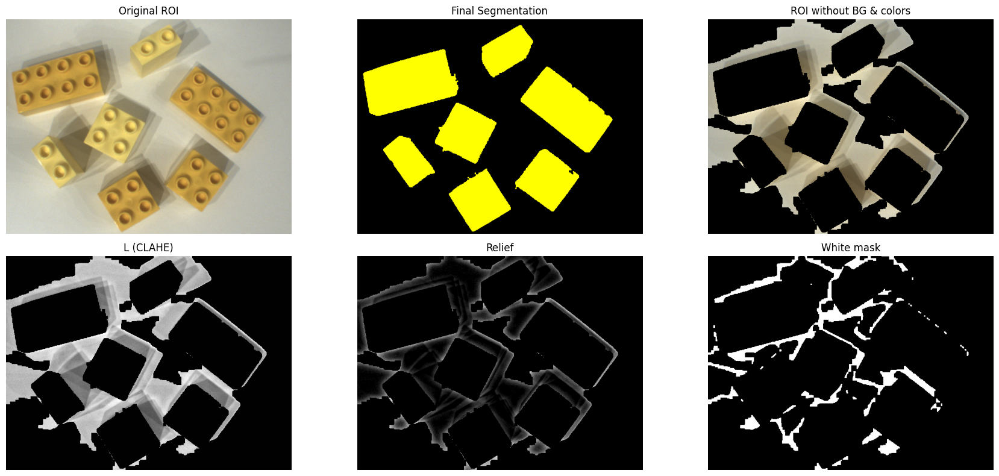

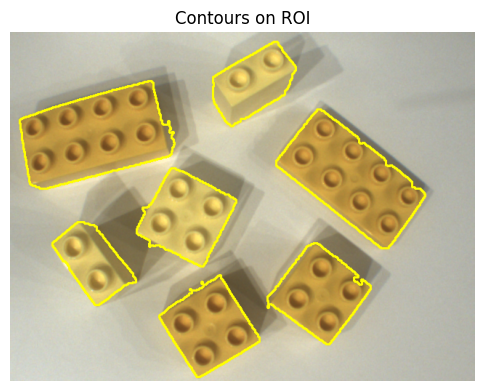

  Count of blocks by color: {'blue': 0, 'green': 0, 'red': 0, 'yellow': 7, 'white': 0}


In [29]:
seg_img, counts, roi_clean, bricks = segment_and_classify_colors(
    roi_bgr=roi,
    show_plot=True,
    debug_white=True,
    show_solution=True
)


print("  Count of blocks by color:", counts)




=== Processing image: blue.png (dominant color: blue) ===


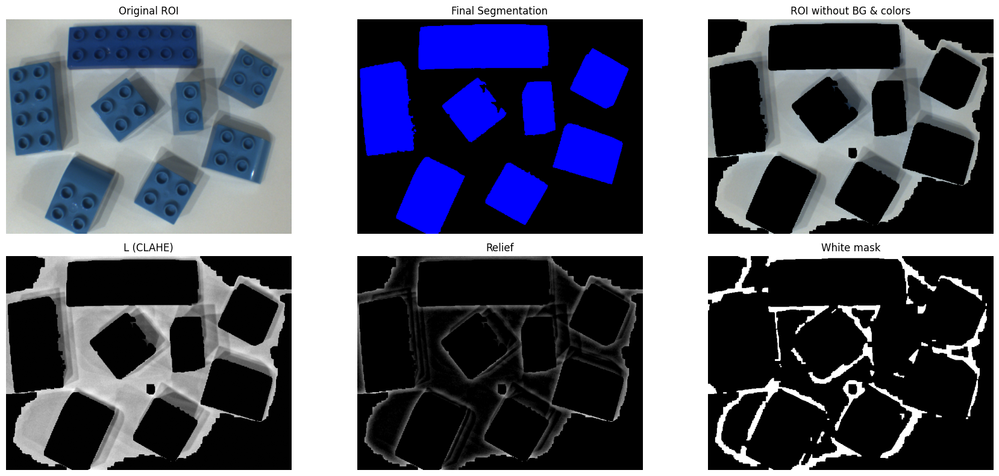

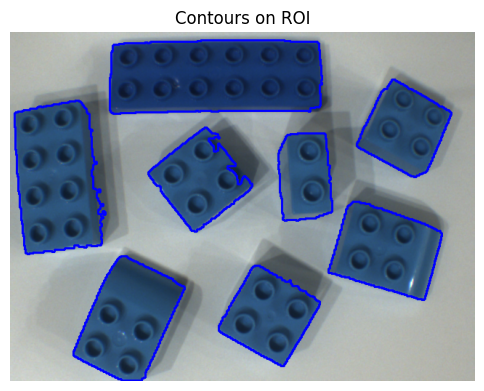

[DEBUG KIT] blue | color=blue, studs=4


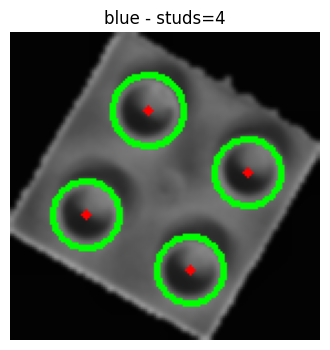

[DEBUG KIT] blue | color=blue, studs=4


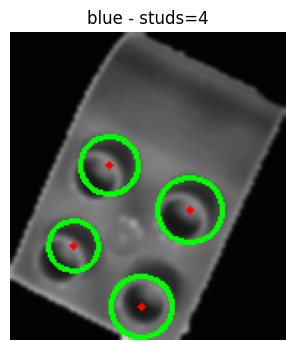

[DEBUG KIT] blue | color=blue, studs=5


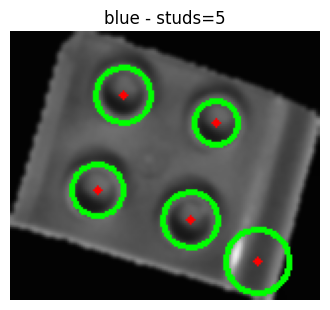

[DEBUG KIT] blue | color=blue, studs=2


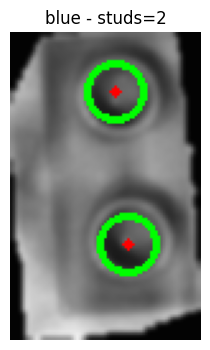

[DEBUG KIT] blue | color=blue, studs=4


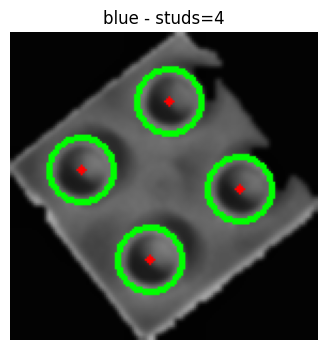

[DEBUG KIT] blue | color=blue, studs=8


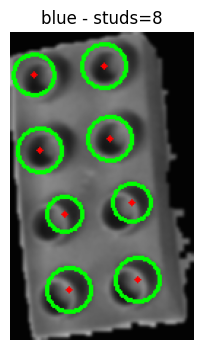

[DEBUG KIT] blue | color=blue, studs=5


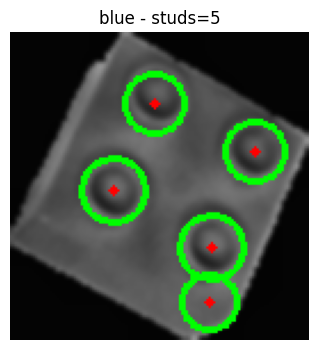

[DEBUG KIT] blue | color=blue, studs=12


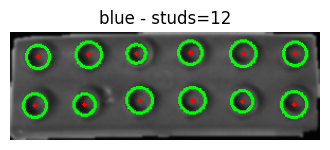

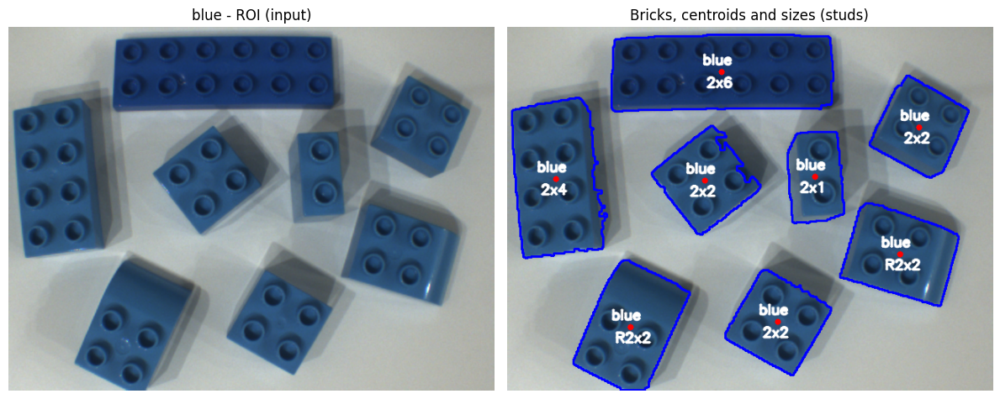

Number of bricks detected: 8

Table for blue.png:
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x1           7731.5            909.72              0.00      1
2x2          10727.3           1262.22             36.28      3
2x4          20849.0           2453.17              0.00      1
2x6          27727.5           3262.52              0.00      1
R2x2         14893.8           1752.45            154.55      2

=== Processing image: green.png (dominant color: green) ===


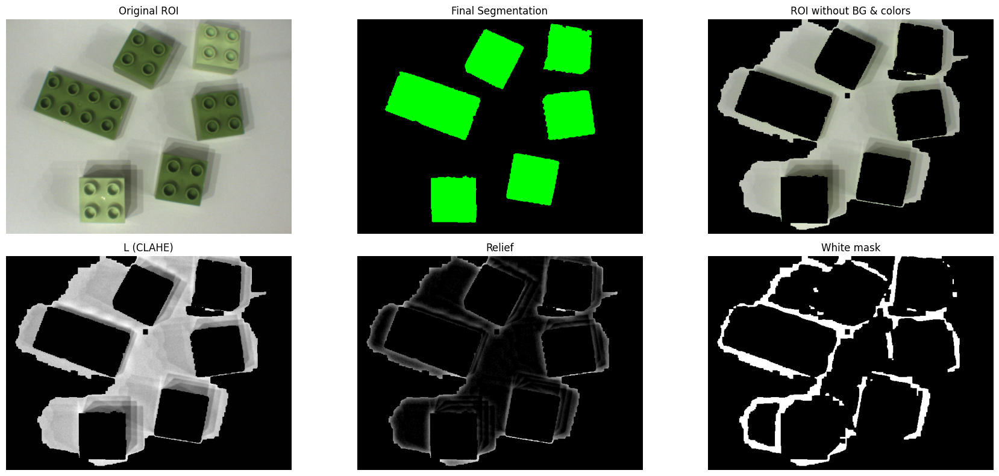

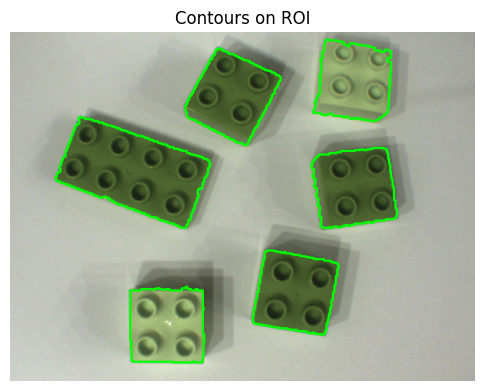

[DEBUG KIT] green | color=green, studs=4


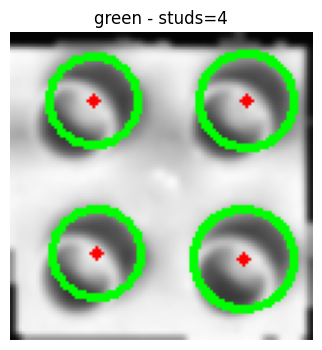

[DEBUG KIT] green | color=green, studs=4


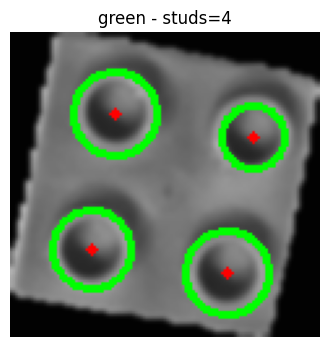

[DEBUG KIT] green | color=green, studs=4


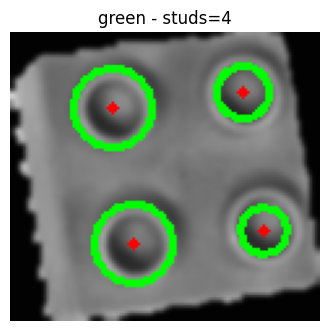

[DEBUG KIT] green | color=green, studs=8


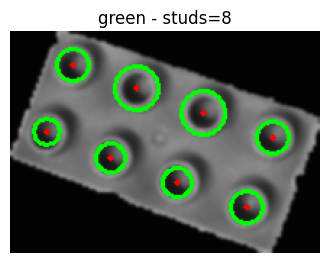

[DEBUG KIT] green | color=green, studs=4


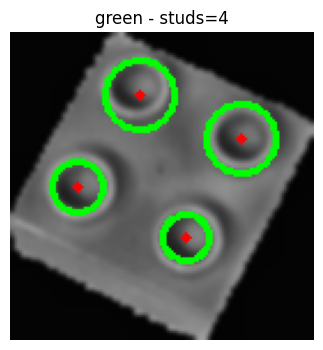

[DEBUG KIT] green | color=green, studs=4


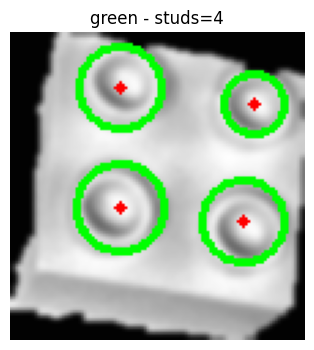

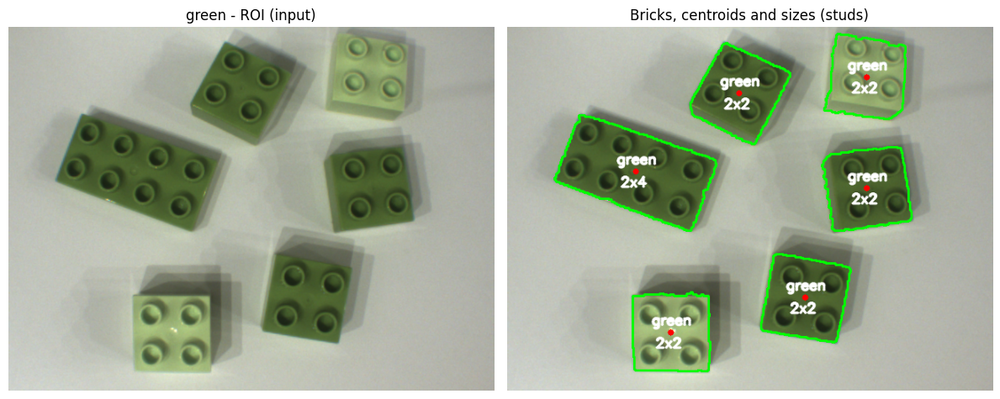

Number of bricks detected: 6

Table for green.png:
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x2          10188.7           1198.84             46.16      5
2x4          18734.0           2204.31              0.00      1

=== Processing image: red.png (dominant color: red) ===


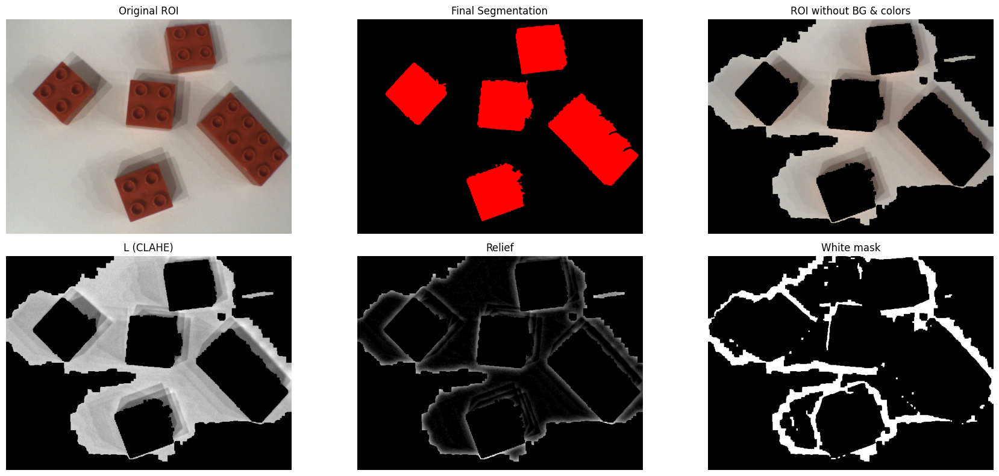

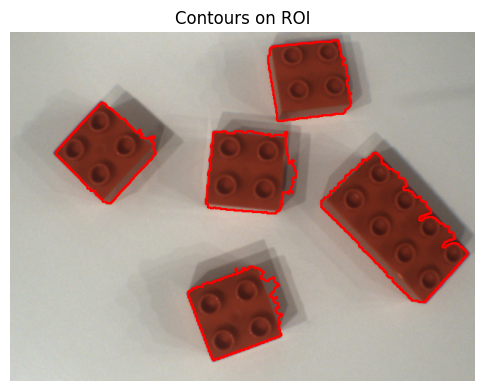

[DEBUG KIT] red | color=red, studs=4


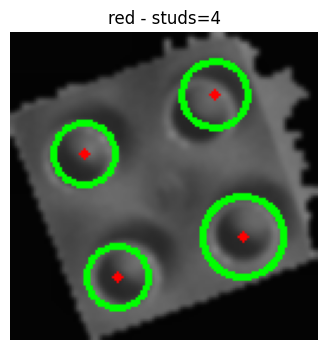

[DEBUG KIT] red | color=red, studs=8


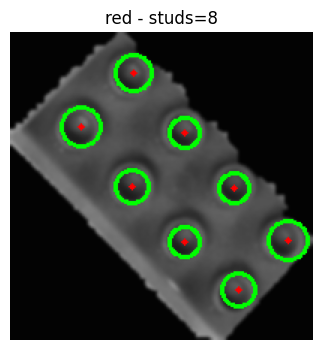

[DEBUG KIT] red | color=red, studs=4


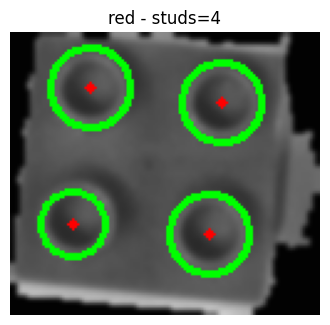

[DEBUG KIT] red | color=red, studs=5


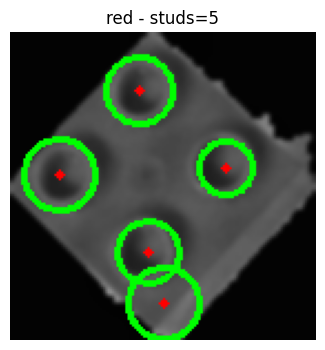

[DEBUG KIT] red | color=red, studs=4


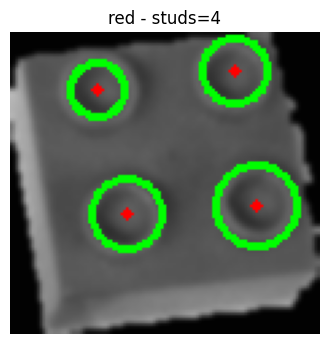

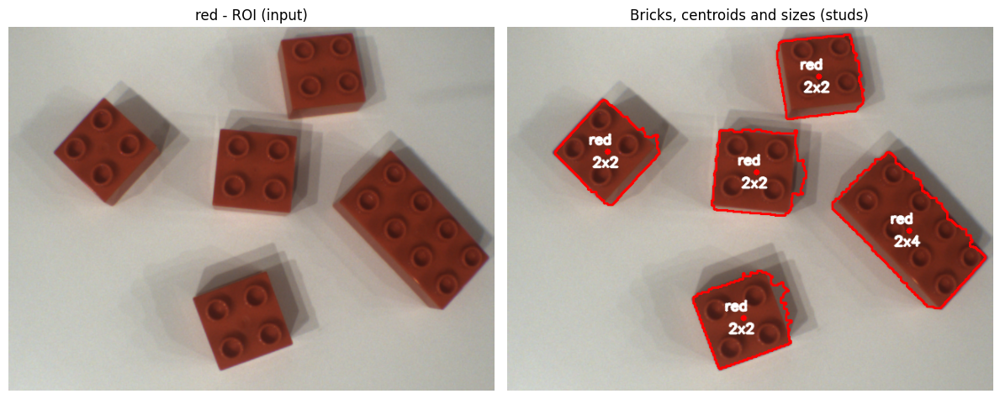

Number of bricks detected: 5

Table for red.png:
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x2          10839.4           1275.40             73.47      4
2x4          20080.0           2362.68              0.00      1

=== Processing image: yellow.png (dominant color: yellow) ===


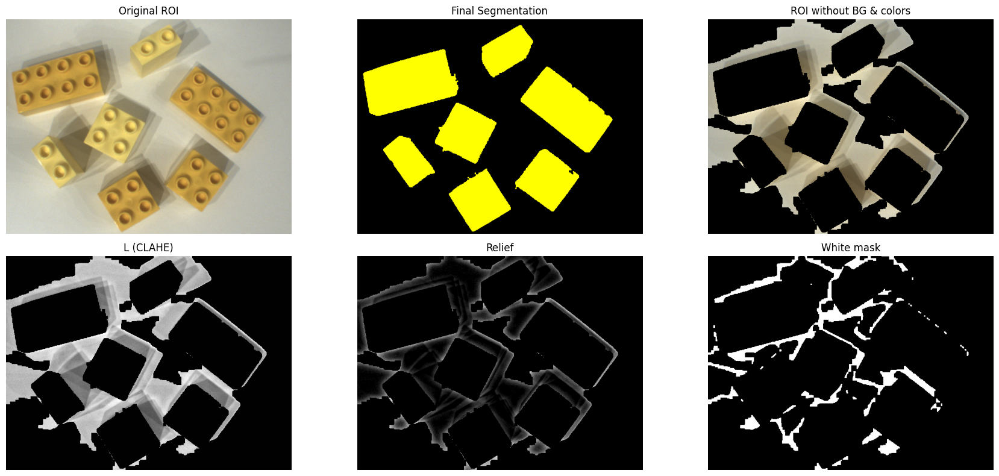

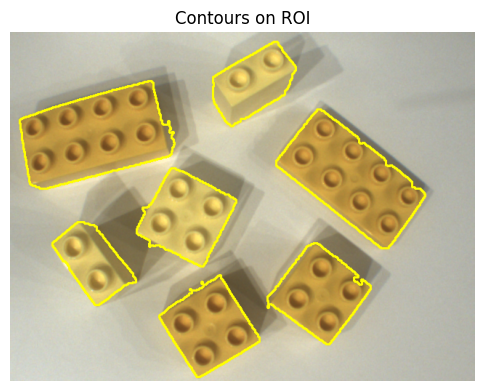

[DEBUG KIT] yellow | color=yellow, studs=4


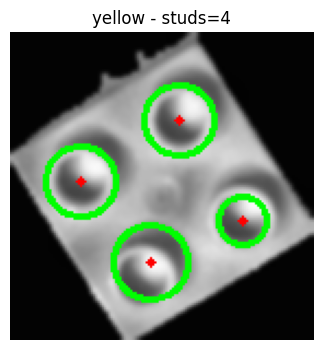

[DEBUG KIT] yellow | color=yellow, studs=5


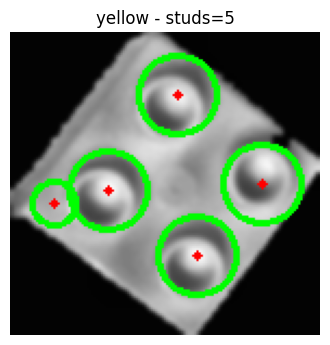

[DEBUG KIT] yellow | color=yellow, studs=2


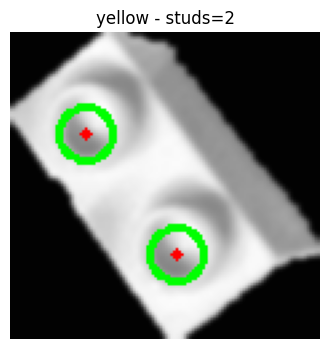

[DEBUG KIT] yellow | color=yellow, studs=4


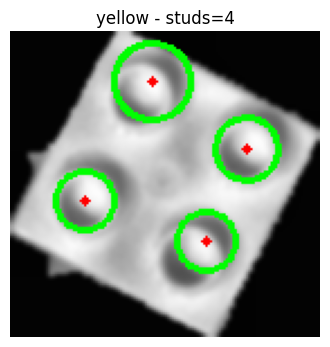

[DEBUG KIT] yellow | color=yellow, studs=8


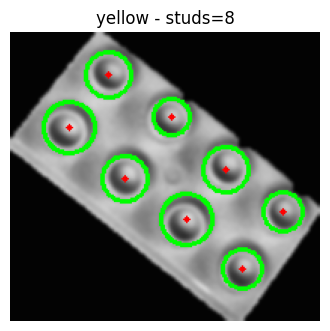

[DEBUG KIT] yellow | color=yellow, studs=8


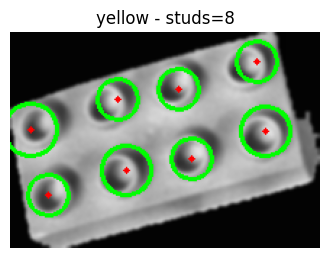

[DEBUG KIT] yellow | color=yellow, studs=2


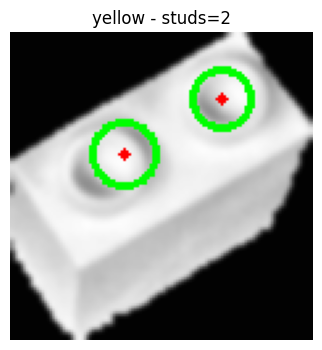

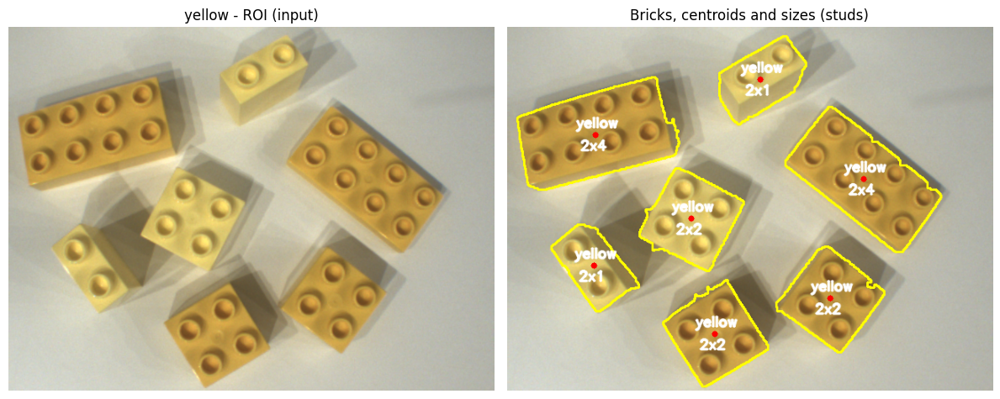

Number of bricks detected: 7

Table for yellow.png:
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x1           7348.8            864.68             80.33      2
2x2          10801.0           1270.88             14.07      3
2x4          19859.0           2336.68            148.60      2

=== Global table (blue + green + red + yellow) ===
Size    Avg Area (px)    Avg Area (mm^2)     Std dev (mm^2)   Count
-------------------------------------------------------------------
2x1           7476.3            879.69             62.47      3
2x2          10592.4           1246.34             56.68     15
2x4          19876.2           2338.71            116.00      5
2x6          27727.5           3262.52              0.00      1
R2x2         14893.8           1752.45            154.55      2


In [30]:
import os
import cv2
import numpy as np

mm2_per_pixel = mm_per_pixel ** 2  # area (mm²) of a single pixel

color_images = {
    "blue":   "data/Isolated/blue.png",
    "green":  "data/Isolated/green.png",
    "red":    "data/Isolated/red.png",
    "yellow": "data/Isolated/yellow.png",
}
DRAW_COLORS_BGR = {
    "blue":   (255,   0,   0),
    "green":  (0,   255,   0),
    "red":    (0,     0, 255),
    "yellow": (0,   255, 255),
    "white":  (255, 255, 255),
}

# To accumulate global statistics across all 4 images
global_areas_by_size = {}

for color_name, path in color_images.items():
    print(f"\n=== Processing image: {os.path.basename(path)} (dominant color: {color_name}) ===")

    img = cv2.imread(path)
    if img is None:
        print(f"[ERROR] Could not read image: {path}")
        continue

    # Use the full image as ROI for isolated bricks
    roi = img.copy()

    # 1) Color segmentation (gets contours and pixel areas)
    seg_img, counts, roi_clean, bricks_seg = segment_and_classify_colors(
        roi_bgr=roi,
        show_plot=True,
        debug_white=True,
        show_solution=True
    )

    # 2) Size detection (studs) + overlay with color & size labels
    overlay, bricks = detect_block_sizes_from_segmentation(
        roi_bgr=roi,
        seg_img=seg_img,
        draw_sizes=True,
        show_plot=True,
        debug_studs=True,
        image_title=color_name
    )


    print(f"Number of bricks detected: {len(bricks)}")

    # --- build per-image statistics: group areas by SIZE ---
    areas_by_size = {}

    for b in bricks:
        size_label = b.get("size", "unknown")
        if size_label == "unknown":
            continue  # skip bricks where the size was not detected

        # area in pixels: prefer 'area_px' if present; otherwise compute from contour
        contour = b["contour"]
        area_px = b.get("area_px", cv2.contourArea(contour))

        if size_label not in areas_by_size:
            areas_by_size[size_label] = []
        areas_by_size[size_label].append(area_px)

        # also accumulate for the global table
        if size_label not in global_areas_by_size:
            global_areas_by_size[size_label] = []
        global_areas_by_size[size_label].append(area_px)

    # --- print per-image table (like the statement asks, but per file) ---
    print(f"\nTable for {os.path.basename(path)}:")
    header = f"{'Size':<6} {'Avg Area (px)':>14} {'Avg Area (mm^2)':>18} {'Std dev (mm^2)':>18} {'Count':>7}"
    print(header)
    print("-" * len(header))

    for size_label in sorted(areas_by_size.keys()):
        areas_px = np.array(areas_by_size[size_label], dtype=float)
        avg_area_px = areas_px.mean()
        avg_area_mm2 = avg_area_px * mm2_per_pixel
        std_area_mm2 = (areas_px.std(ddof=1) if len(areas_px) > 1 else 0.0) * mm2_per_pixel

        print(
            f"{size_label:<6}"
            f"{avg_area_px:14.1f}"
            f"{avg_area_mm2:18.2f}"
            f"{std_area_mm2:18.2f}"
            f"{len(areas_px):7d}"
        )

# ---------- global table across all 4 color images ----------
print("\n=== Global table (blue + green + red + yellow) ===")
header = f"{'Size':<6} {'Avg Area (px)':>14} {'Avg Area (mm^2)':>18} {'Std dev (mm^2)':>18} {'Count':>7}"
print(header)
print("-" * len(header))

for size_label in sorted(global_areas_by_size.keys()):
    areas_px = np.array(global_areas_by_size[size_label], dtype=float)
    avg_area_px = areas_px.mean()
    avg_area_mm2 = avg_area_px * mm2_per_pixel
    std_area_mm2 = (areas_px.std(ddof=1) if len(areas_px) > 1 else 0.0) * mm2_per_pixel

    print(
        f"{size_label:<6}"
        f"{avg_area_px:14.1f}"
        f"{avg_area_mm2:18.2f}"
        f"{std_area_mm2:18.2f}"
        f"{len(areas_px):7d}"
    )


## ================================================================================================================

## **Preliminary Attempts**

Although several early implementations were able to capture white bricks in many test images, they failed to generalize. When applied to different lighting conditions or other LEGO scenes, these approaches often missed even the more distinguishable colors such as blue or green. This motivated the development of the final method, which, despite still struggling with white detection, demonstrated the most stable and promising behavior.

### **1st Attempt**

This method combines color-based and shape-based detection. It first identifies colored bricks in the HSV space using predefined color ranges and simple morphological cleaning. For bricks missed by this step, mainly white ones, it uses edge detection and contour filtering to find rectangular shapes. All detected boxes are merged and classified by the median HSV values of their pixels. While the method performs well on some images, it fails to generalize, especially under different lighting conditions.

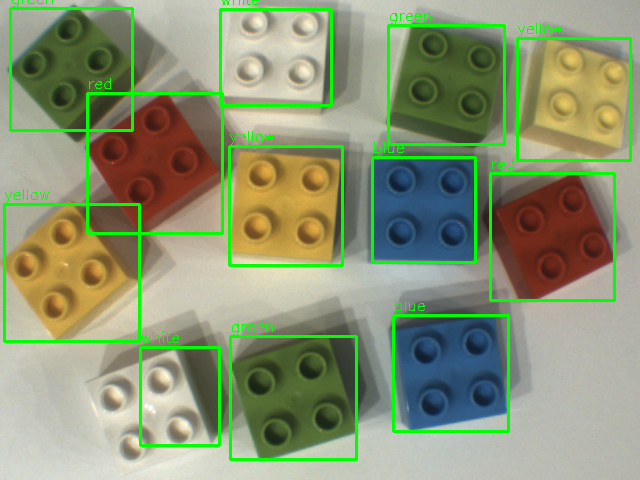

Brick counts by color:
{'red': 2, 'green': 3, 'blue': 2, 'yellow': 3, 'white': 2, 'unknown': 0}


In [36]:
def count_bricks(
    path_img: str = None,
    img_bgr: np.ndarray = None,
    roi_rect: tuple = None,
    show_debug: bool = True,
):
    if path_img is not None:
        img = cv2.imread(path_img)
        if img is None:
            raise ValueError(f"Could not read image: {path_img}")
    elif img_bgr is not None:
        img = img_bgr.copy()
    else:
        raise ValueError("Provide either 'path_img' or 'img_bgr'.")

    if roi_rect is not None:
        x0, y0, w0, h0 = roi_rect
        img = img[y0:y0+h0, x0:x0+w0]

    blur = cv2.GaussianBlur(img, (5,5), 0)
    hsv  = cv2.cvtColor(blur, cv2.COLOR_BGR2HSV)

    ranges_color = {
        "red": [
            (np.array([0,   80,  60]), np.array([10, 255,255])),
            (np.array([170, 80,  60]), np.array([180,255,255])),
        ],
        "green": [ (np.array([40,  60,  60]), np.array([85, 255,255])) ],
        "blue":  [ (np.array([90,  60,  60]), np.array([130,255,255])) ],
        "yellow":[ (np.array([20,  60,  60]), np.array([40, 255,255])) ],
    }

    kernel = np.ones((5,5), np.uint8)
    color_boxes = []

    for _, bounds_list in ranges_color.items():
        mask_total = None
        for (lower, upper) in bounds_list:
            mask_part = cv2.inRange(hsv, lower, upper)
            mask_total = mask_part if mask_total is None else cv2.bitwise_or(mask_total, mask_part)

        mask_clean = cv2.morphologyEx(mask_total, cv2.MORPH_OPEN, kernel)
        mask_clean = cv2.morphologyEx(mask_clean, cv2.MORPH_CLOSE, kernel)

        contours_c, _ = cv2.findContours(mask_clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        for c in contours_c:
            area = cv2.contourArea(c)
            if area < 1500:
                continue
            x,y,w,h = cv2.boundingRect(c)
            color_boxes.append((x,y,w,h))

    def iou(boxA, boxB):
        ax, ay, aw, ah = boxA
        bx, by, bw, bh = boxB
        ax2, ay2 = ax+aw, ay+ah
        bx2, by2 = bx+bw, by+bh
        inter_x1 = max(ax, bx)
        inter_y1 = max(ay, by)
        inter_x2 = min(ax2, bx2)
        inter_y2 = min(ay2, by2)
        inter_w = max(0, inter_x2 - inter_x1)
        inter_h = max(0, inter_y2 - inter_y1)
        inter_area = inter_w * inter_h
        areaA = aw*ah
        areaB = bw*bh
        denom = areaA + areaB - inter_area + 1e-6
        return inter_area / denom

    gray = cv2.cvtColor(blur, cv2.COLOR_BGR2GRAY)
    lap = cv2.Laplacian(gray, cv2.CV_16S, ksize=3)
    lap_abs = cv2.convertScaleAbs(lap)
    _, thresh = cv2.threshold(lap_abs, 20, 255, cv2.THRESH_BINARY)

    kernel_close = np.ones((9,9), np.uint8)
    thresh_closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel_close)
    kernel_open = np.ones((5,5), np.uint8)
    thresh_clean = cv2.morphologyEx(thresh_closed, cv2.MORPH_OPEN, kernel_open)

    contours_s, _ = cv2.findContours(thresh_clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    shape_boxes_all = []
    for c in contours_s:
        x,y,w,h = cv2.boundingRect(c)
        area = cv2.contourArea(c)
        ratio = w / float(h) if h>0 else 0
        if w < 45 or h < 45: continue
        if w > 150 or h > 150: continue
        if area < 1500 or area > 20000: continue
        if ratio < 0.5 or ratio > 2.0: continue
        shape_boxes_all.append((x,y,w,h))

    shape_boxes_filtered = []
    for sb in shape_boxes_all:
        if not any(iou(sb, cb) > 0.3 for cb in color_boxes):
            shape_boxes_filtered.append(sb)

    all_candidates = color_boxes + shape_boxes_filtered
    final_boxes = []
    for b in all_candidates:
        if not any(iou(b, fb) > 0.5 for fb in final_boxes):
            final_boxes.append(b)

    def classify_color_patch(patch_bgr):
        patch_hsv = cv2.cvtColor(patch_bgr, cv2.COLOR_BGR2HSV)
        H,S,V = cv2.split(patch_hsv)
        h_med = float(np.median(H))
        s_med = float(np.median(S))
        v_med = float(np.median(V))
        if s_med > 60:
            if (h_med <= 10) or (h_med >= 160): return "red"
            if 20 <= h_med <= 40: return "yellow"
            if 40 < h_med <= 85: return "green"
            if 90 <= h_med <= 130: return "blue"
            return "unknown"
        else:
            if v_med > 100: return "white"
            else: return "unknown"

    counts = {"red":0,"green":0,"blue":0,"yellow":0,"white":0,"unknown":0}
    debug = img.copy()

    for (x,y,w,h) in final_boxes:
        patch = img[y:y+h, x:x+w]
        label = classify_color_patch(patch)
        counts[label] += 1
        cv2.rectangle(debug, (x,y), (x+w,y+h), (0,255,0), 2)
        cv2.putText(debug, label, (x,y-5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0), 1)

    if show_debug:
        try:
            from google.colab.patches import cv2_imshow
            cv2_imshow(debug)
        except Exception:
            pass

    print("Brick counts by color:")
    print(counts)
    return counts, debug

counts, dbg = count_bricks(path_img="data/Isolated/colored_bricks.png")

### **2nd Attempt**

This method improves on the previous one by combining color segmentation with a more sophisticated process for detecting white bricks. It first isolates colored regions in HSV space and filters them by shape, as before. For white detection, it uses Laplacian edges and adaptive thresholding to identify bright, low-saturation regions, which are then refined with local brightness normalization and morphological merging to join fragmented pieces. The method then merges all detections, removes duplicates, and classifies each region based on its mean HSV values. Although it performs better in some lighting conditions and captures white bricks more often, it still lacks consistency and fails to generalize across different images

Brick counts by color:
{'red': 2, 'green': 3, 'blue': 2, 'yellow': 3, 'white': 2}


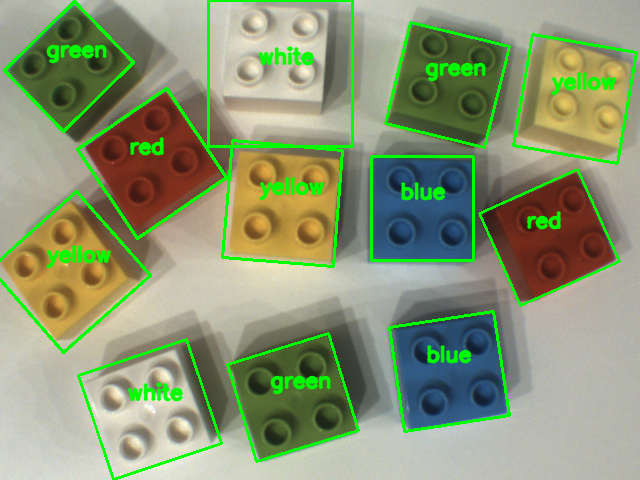

In [37]:
# ===================== load image =====================
IMG_PATH = "data/Isolated/colored_bricks.png"
img = cv2.imread(IMG_PATH)
assert img is not None, f"Could not open: {IMG_PATH}"
draw = img.copy()
H, W = img.shape[:2]
area_img = H * W

# ===================== preprocessing ==================
blur = cv2.GaussianBlur(img, (5,5), 0)
hsv  = cv2.cvtColor(blur, cv2.COLOR_BGR2HSV)
gray = cv2.cvtColor(blur, cv2.COLOR_BGR2GRAY)

# ===================== edges (for shape) ===============
med  = np.median(gray)
low  = int(max(0, 0.66*med)); high = int(min(255, 1.33*med))
edges = cv2.Canny(gray, low, high)
edges = cv2.dilate(edges, np.ones((3,3), np.uint8), 1)

# ===================== HSV (strong colors) =============
ranges_hsv = {
    "red":   [((0,80,60),(10,255,255)), ((170,80,60),(180,255,255))],
    "green": [((40,60,60),(85,255,255))],
    "blue":  [((90,60,45),(130,255,255))],
    "yellow":[((18,60,60),(45,255,255))],
}

def clean(mask):
    k = np.ones((5,5),np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN,  k, 1)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, k, 2)
    return mask

def find_boxes_from_mask(mask, amin=1500, amax_frac=0.12):
    cnts,_ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    out = []
    for c in cnts:
        a = cv2.contourArea(c)
        if a < amin or a > amax_frac*area_img:
            continue
        rect = cv2.minAreaRect(c)
        (cx,cy),(w,h),ang = rect
        if w<40 or h<40 or w>200 or h>220:
            continue
        ar = w/(h+1e-6)
        if ar < 0.55 or ar > 1.85:
            continue
        out.append((rect,c))
    return out

# color masks → candidates
masks = {}
for cname, bounds in ranges_hsv.items():
    m_total = None
    for lo,hi in bounds:
        m = cv2.inRange(hsv, np.array(lo), np.array(hi))
        m_total = m if m_total is None else cv2.bitwise_or(m_total, m)
    masks[cname] = clean(m_total)

candidates = []
for cname, m in masks.items():
    for rect, cnt in find_boxes_from_mask(m):
        candidates.append({"rect":rect, "contour":cnt, "hint":cname})

# ===================== white blocks =====================
# Laplacian + Otsu for white edges
lap = cv2.Laplacian(gray, cv2.CV_16S, ksize=3)
lap_abs = cv2.convertScaleAbs(lap)
_, edge_bin = cv2.threshold(lap_abs, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)

edge_bin = cv2.morphologyEx(edge_bin, cv2.MORPH_CLOSE, np.ones((9,9), np.uint8), 1)
edge_bin = cv2.morphologyEx(edge_bin, cv2.MORPH_OPEN,  np.ones((5,5), np.uint8), 1)

# Local brightness and low saturation for white
V = hsv[:,:,2]; S = hsv[:,:,1]
V_bg   = cv2.GaussianBlur(V, (51,51), 0)
V_ratio= (V.astype(np.float32)+1) / (V_bg.astype(np.float32)+1)
V_norm = cv2.normalize(V_ratio, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

roi_vals = V_norm[edge_bin>0]
v_th = int(np.percentile(roi_vals, 55)) if roi_vals.size>0 else 150
mask_v = cv2.inRange(V_norm, v_th, 255)
mask_s = cv2.inRange(S, 0, 70)

white_mask = cv2.bitwise_and(edge_bin, cv2.bitwise_and(mask_v, mask_s))

# merge white fragments
white_mask = cv2.morphologyEx(white_mask, cv2.MORPH_CLOSE, np.ones((11,11), np.uint8), 2)
white_mask = cv2.morphologyEx(white_mask, cv2.MORPH_OPEN,  np.ones((5,5),  np.uint8), 1)

MERGE_CLOSE = 14
MERGE_DIL   = 3
white_merge = cv2.morphologyEx(white_mask, cv2.MORPH_CLOSE, np.ones((MERGE_CLOSE,MERGE_CLOSE), np.uint8), 1)
white_merge = cv2.dilate(white_merge, np.ones((MERGE_DIL,MERGE_DIL), np.uint8), 1)

# boxes from merged white mask
white_rects = find_boxes_from_mask(white_merge, amin=600, amax_frac=0.12)
for rect, cnt in white_rects:
    candidates.append({"rect":rect, "contour":cnt, "hint":"white"})

# ===================== deduplication =====================
def rect_to_bbox(rect):
    pts = cv2.boxPoints(rect)
    x1, y1 = pts[:,0].min(), pts[:,1].min()
    x2, y2 = pts[:,0].max(), pts[:,1].max()
    return [x1, y1, x2, y2]

def bbox_iou(a, b):
    ax1, ay1, ax2, ay2 = a
    bx1, by1, bx2, by2 = b
    inter_x1, inter_y1 = max(ax1, bx1), max(ay1, by1)
    inter_x2, inter_y2 = min(ax2, bx2), min(ay2, by2)
    iw, ih = max(0, inter_x2-inter_x1), max(0, inter_y2-inter_y1)
    inter = iw*ih
    area_a = (ax2-ax1)*(ay2-ay1) + 1e-6
    area_b = (bx2-bx1)*(ay2-ay1) + 1e-6
    return inter / (area_a + area_b - inter + 1e-6)

def center(rect):
    (cx,cy),(w,h),ang = rect
    return np.array([cx,cy], np.float32), min(w,h)

def is_duplicate(new_rect, existing_rects, scale=0.85, iou_thr=0.25):
    c_new, s_new = center(new_rect)
    bb_new = rect_to_bbox(new_rect)
    for r in existing_rects:
        c_old, s_old = center(r)
        if np.linalg.norm(c_new - c_old) < scale*max(s_new, s_old):
            return True
        if bbox_iou(bb_new, rect_to_bbox(r)) > iou_thr:
            return True
    return False

final = []
for cand in candidates:
    if not is_duplicate(cand["rect"], [f["rect"] for f in final]):
        final.append(cand)

# ===================== classification & drawing =====================
def label_from_means(hm, sm, vm):
    if sm < 45 and vm > 175: return "white"
    if 20 <= hm < 35 and sm > 60: return "yellow"
    if 35 <= hm < 85 and sm > 55: return "green"
    if 90 <= hm < 130 and sm > 45: return "blue"
    if (hm < 12 or hm >= 160) and sm > 55: return "red"
    return "unknown"

counts = Counter({"red":0,"green":0,"blue":0,"yellow":0,"white":0})

for cand in final:
    if cand.get("hint") == "white":
        lbl = "white"
    else:
        mask = np.zeros((H, W), np.uint8)
        cv2.drawContours(mask, [cand["contour"]], -1, 255, -1)
        hm, sm, vm, _ = cv2.mean(hsv, mask=mask)
        lbl = label_from_means(hm, sm, vm)
        if lbl == "unknown" and "hint" in cand:
            lbl = cand["hint"]

    counts[lbl] += 1
    box = cv2.boxPoints(cand["rect"]).astype(int)
    cv2.polylines(draw, [box], True, (0,255,0), 2)
    cx, cy = box[:,0].mean().astype(int), box[:,1].mean().astype(int)
    cv2.putText(draw, lbl, (cx-22, cy-10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0,255,0), 2, cv2.LINE_AA)

print("Brick counts by color:")
print(dict(counts))
cv2_imshow(draw)


## **Limitations and Future Work**

Despite the progress achieved in the segmentation and color classification of LEGO-like bricks, the detection of white bricks was not successfully accomplished in this work.

Several approaches were tested, including different color spaces, adaptive thresholding, and illumination correction techniques and although none produced fully satisfactory results, the implemented method based on LAB, CLAHE, and local contrast enhancement showed the most promising behavior.

We believe that this approach is on the right track, as it effectively isolates bright regions under varying lighting conditions, but further refinement and controlled acquisition conditions will likely be necessary to achieve robust white brick detection in future iterations of this project.